## Import Libraries

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
from rdflib import Graph
from SPARQLWrapper import SPARQLWrapper, JSON, N3
from pprint import pprint
import wikidata_plain_sparql as wikidata
import pandas as pd
import numpy as np
import time
import pickle
from tqdm import trange, tqdm
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from statsmodels.formula.api import (negativebinomial, poisson,)
from statsmodels.discrete.discrete_model import NegativeBinomialP, NegativeBinomial, Poisson, GeneralizedPoisson
from statsmodels.discrete.count_model import (ZeroInflatedNegativeBinomialP, ZeroInflatedPoisson,
                                              ZeroInflatedGeneralizedPoisson)
import statsmodels.discrete._diagnostics_count as dia

import statsmodels.api as sm
from scipy.stats import chi2_contingency
from scipy.stats import chi2
from scipy.stats import entropy
from patsy import dmatrices
#from patsy import ZeroInflated
import random
from functools import reduce
from collections import Counter

import networkx as nx
import ast

#from statsmodels.discrete.discrete_model import Poisson
#from statsmodels.discrete.diagnostic import PoissonDiagnostic
sns.set(context='poster', font_scale=0.5, style='whitegrid', )

/Users/Rachel/opt/anaconda3/lib/python3.8/site-packages/rdflib_jsonld/__init__.py:9: DeprecationWarning: The rdflib-jsonld package has been integrated into rdflib as of rdflib==6.0.1.  Please remove rdflib-jsonld from your project's dependencies.
  warnings.warn(


## Load data

In [3]:
df = pickle.load(open( "data/df.p", "rb" ))
df.head(1)

,Name,wikidata,Wikipedia_URL,Wikidata_URL,Wikidata_Q,lang,n_lang,Outlinks,Inlinks,gender_Q,...,child_Q,child,father_Q,father,mother_Q,mother,prop_list,prop_notability_list,n_prop_list,n_prop_notability_list
0,Ceolwulf,Y,https://en.wikipedia.org/wiki/Ceolwulf_of_Nort...,http://www.wikidata.org/entity/Q729480,Q729480,"[bar, ca, de, el, en, eo, es, fr, gl, it, la, ...",15,"{'Q154938': 'Bede', 'Q338268': 'Acca of Hexham...","{'Q737618': 'Aldfrith of Northumbria', 'Q15493...",http://www.wikidata.org/entity/Q6581097,...,NaN,NaN,http://www.wikidata.org/entity/Q75451525,Cuðwin (?),NaN,NaN,"[P27, P646, P569, P1185, P1343, P227, P97, P57...","[P227, P6126, P7902, P1415]",29,4


In [4]:
df_manual = pd.read_csv('data/name_info_no_duplicates.csv')
df_manual.head(1)

,Name,Book,Chapter,Gender,Named/Unnamed
0,Ceolwulf,Preface,Preface,M,N


In [5]:
df_cv = pd.DataFrame()
for df_chunk in tqdm(pd.read_csv('data/cross-verified-database.csv', encoding='latin-1', chunksize=10000)):
    qids = set(df_chunk['wikidata_code'].values).intersection(set(df.Wikidata_Q))
    for qid in qids:
        df_cv = df_cv.append(df_chunk[df_chunk.wikidata_code == qid])
df_cv.head(1)

230it [00:17, 12.99it/s]


,wikidata_code,birth,death,approx_birth,approx_death,birth_min,birth_max,death_min,death_max,gender,...,area2_of_rattachment,list_wikipedia_editions,un_region,group_wikipedia_editions,bplo1,dplo1,bpla1,dpla1,pantheon_1,level3_all_occ
6784,Q495540,NaN,685.0,century,NaN,601.0,700.0,685.0,685.0,Male,...,Missing,dewiki|eowiki|brwiki|plwiki|ruwiki|shwiki|enwi...,Europe,grA,NaN,NaN,NaN,NaN,0,D:_politician_P:_ king_English_ roi_French_ kÃ...


In [6]:
# Centrality values in Prado et al. 2020

# df_pre = pd.read_csv('data/pre_calculated.csv')
# df_pre.head(1)

## Preprocessing

### Gender (manually labelled)

In [7]:
df = pd.concat([df, df_manual.Gender], axis=1)

In [8]:
df.rename(columns={'Gender':'gender_manual'}, inplace=True)

In [9]:
for i in df.index:
    if df.at[i, 'gender_manual'] == 'M':
        df.at[i, 'gender_manual'] = 'male'
    if df.at[i, 'gender_manual'] == 'F':
        df.at[i, 'gender_manual'] = 'female'
    if df.at[i, 'gender_manual'] == 'X':
        df.at[i, 'gender_manual'] = 'mixed'

In [10]:
for i in df.index:
    if df.at[i,'gender'] != df.at[i,'gender_manual']: 
        if df.at[i,'wikidata']=='Y':
            print(i, df.at[i,'Name'],  df.at[i,'gender_manual'])

562 Michael mixed


### Year

In [11]:
for i in df.index:
    date = df.at[i, 'date_of_death']
    if type(date)==list:
        date = date[0]
    if not pd.isna(date):
        if type(date) == str:
            if date[0].isnumeric():
                df.at[i, 'date_of_death'] = int(date[:4])
            elif date[0] == '-':
                df.at[i, 'date_of_death'] = int(date[:5])
            else:
                df.at[i, 'date_of_death'] = ''
                #print(i, df.at[i, 'Name'], df.at[i, 'Wikidata_URL'], '\n', df.at[i, 'date_of_death_Q'],)

for i in df.index:
    date = df.at[i, 'date_of_birth']
    if type(date)==list:
        date = date[0]
    if not pd.isna(date):
        if type(date) == str:
            if date[0].isnumeric():
                df.at[i, 'date_of_birth'] = int(date[:4])
            elif date[0] == '-':
                df.at[i, 'date_of_birth'] = int(date[:5])
            else:
                df.at[i, 'date_of_birth'] = ''

df['date_of_death'] = pd.to_numeric(df['date_of_death'])
df['date_of_birth'] = pd.to_numeric(df['date_of_birth'])

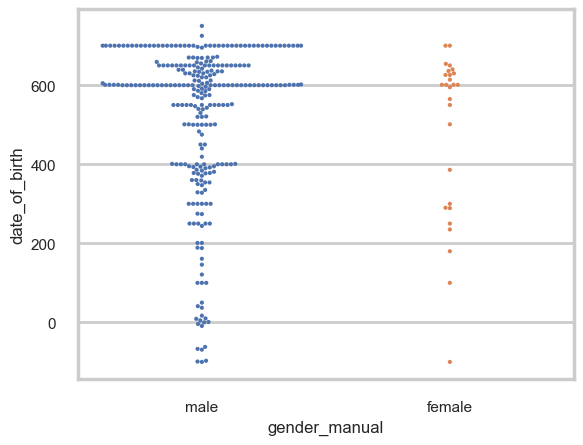

In [12]:
#birth
plt.figure(dpi=100)
sns.swarmplot(x='gender_manual', y='date_of_birth', \
              data=df[(df.gender_manual!='mixed') & (df.date_of_birth > -200)], size=3)
plt.show()

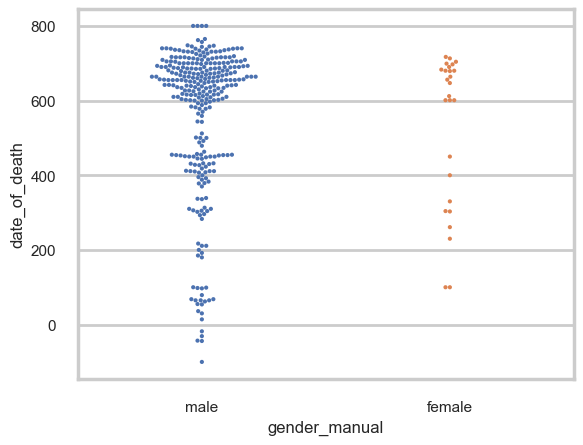

In [13]:
#death
plt.figure(dpi=100)
sns.swarmplot(x='gender_manual', y='date_of_death', data=df[df.gender_manual!='mixed'], size=3)
plt.show()

In [14]:
df['year_of_birth'] = df['date_of_birth']
for i in df.index:
    Q_code = df.at[i,'Wikidata_Q']
    if type(Q_code) == str and Q_code in list(df_cv.wikidata_code):
        year1 = df.at[i,'date_of_birth']
        year2 = df_cv[df_cv.wikidata_code == Q_code]['birth'].iloc[0]
        if year1 != year2 and pd.isna(year1) and not pd.isna(year2) and year2<=800:
            print('A', Q_code, year1, year2)
            df.at[i, 'year_of_birth'] = year2
        if year1 != year2 and year1 % 100 == 0 and not pd.isna(year2) and year2<=800:
            print('B', Q_code, year1, year2)
            df.at[i, 'year_of_birth'] = year2

A Q101090 nan 130.0
B Q102371 400.0 376.0
A Q313490 nan 390.0
A Q36724 nan 406.0
A Q25176141 nan 429.0
B Q170299 600.0 575.0
B Q888956 700.0 627.0
B Q879949 600.0 633.0
A Q453676 nan 645.0
A Q16207995 nan 676.0
A Q1263119 nan 344.0
A Q3717838 nan 615.0
B Q51885 100.0 30.0
B Q210096 300.0 291.0
A Q381292 nan 657.0
B Q737618 600.0 634.0
B Q463984 700.0 650.0
B Q715856 700.0 675.0
B Q103314 700.0 664.0
A Q365941 nan 385.0


In [15]:
df['year_of_death'] = df['date_of_death']
for i in df.index:
    Q_code = df.at[i,'Wikidata_Q']
    if type(Q_code) == str and Q_code in list(df_cv.wikidata_code):
        year1 = df.at[i,'date_of_death']
        year2 = df_cv[df_cv.wikidata_code == Q_code]['death'].iloc[0]
        if year1 != year2 and pd.isna(year1) and not pd.isna(year2) and year2<=900:
            print('A', Q_code, year1, year2)
            df.at[i, 'year_of_death'] = year2
        if year1 != year2 and year1 % 100 == 0 and not pd.isna(year2) and year2<=900:
            print('B', Q_code, year1, year2)
            df.at[i, 'year_of_death'] = year2

B Q335127 100.0 58.0
A Q603233 nan 275.0
A Q18279781 nan 605.0
A Q7786837 nan 652.0
A Q4672237 nan 705.0
A Q4879472 nan 693.0
A Q888573 nan 700.0
B Q15982432 700.0 678.0
B Q210096 400.0 305.0
B Q707833 800.0 745.0
B Q4947224 700.0 691.0
A Q381292 nan 680.0
A Q5381781 nan 716.0


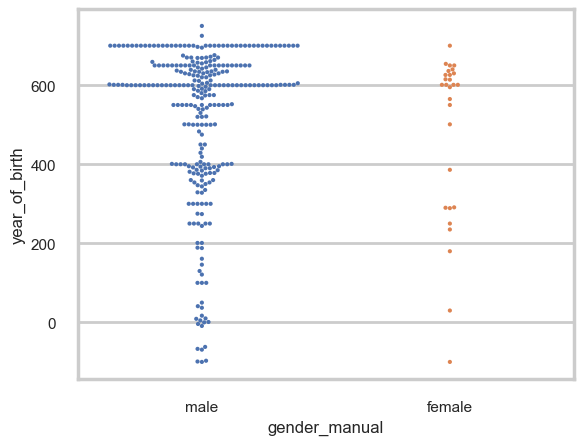

In [16]:
#year of birth
plt.figure(dpi=100)
sns.swarmplot(x='gender_manual', y='year_of_birth', \
              data=df[(df.gender_manual!='mixed') & (df.year_of_birth > -200)], size=3)
plt.show()

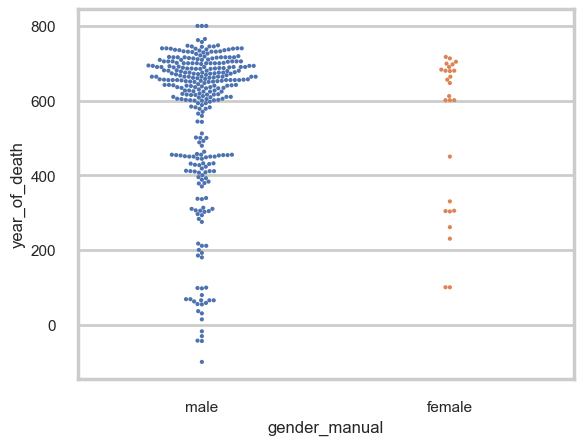

In [17]:
#year of death
plt.figure(dpi=100)
sns.swarmplot(x='gender_manual', y='year_of_death', data=df[df.gender_manual!='mixed'], size=3)
plt.show()

### language editions modified

In [18]:
df['n_lang_modified'] = df['n_lang']
for i in df.index:
    if pd.isna(df.at[i,'n_lang_modified']) or df.at[i,'n_lang_modified']=='':
        df.at[i,'n_lang_modified'] = 0

In [19]:
df['n_lang_modified'] = pd.to_numeric(df['n_lang_modified'])

### notability property numbers modified

In [20]:
df['n_prop_notability_list_modified'] = df['n_prop_notability_list']
for i in df.index:
    if pd.isna(df.at[i,'n_prop_notability_list_modified']) or df.at[i,'n_prop_notability_list_modified']=='':
        df.at[i,'n_prop_notability_list_modified'] = 0
df['n_prop_notability_list_modified'] = pd.to_numeric(df['n_prop_notability_list_modified'])

### occupation

In [21]:
#df_cv[['level1_main_occ','level2_main_occ', 'level3_main_occ']].groupby(['level1_main_occ','level2_main_occ', 'level3_main_occ']).value_counts()

In [22]:
df['occupation_level1_modified']=''
df['occupation_level2_modified']=''
df['occupation_level3_modified']=''
for i in df.index:
    temp = df_cv[df_cv.wikidata_code == df.at[i,'Wikidata_Q']]
    if len(temp)==1:
        df.at[i, 'occupation_level1_modified'] = temp['level1_main_occ'].to_list()[0]
        df.at[i, 'occupation_level2_modified'] = temp['level2_main_occ'].to_list()[0]
        df.at[i, 'occupation_level3_modified'] = temp['level3_main_occ'].to_list()[0]

In [23]:
for i in df.index:
    if type(df.at[i, 'occupation']) == list:
        df.at[i, 'occupation'] = df.at[i, 'occupation'][0]

In [24]:
df[df['occupation_level3_modified']==''].occupation.dropna()

31               monarch
77             sovereign
80             sovereign
81             mercenary
86               monarch
96               monarch
249                  nun
303           aristocrat
304                  nun
317           missionary
318      Catholic priest
328      Catholic priest
356              prelate
366    religious servant
384                  nun
398      Catholic priest
458      Catholic priest
515           politician
516           missionary
517           missionary
Name: occupation, dtype: object

In [25]:
for i in df[df['occupation_level3_modified']==''].occupation.dropna().index:
    occ = df.at[i,'occupation']
    if occ == 'Catholic priest':
        occ = 'priest'
    df.at[i,'occupation_level3_modified'] = occ
    if occ in ['monarch', 'sovereign', 'aristocrat',]:
        df.at[i,'occupation_level2_modified'] = 'Nobility'
        df.at[i,'occupation_level1_modified'] = 'Leadership'
    if occ in ['mercenary',]:
        df.at[i,'occupation_level2_modified'] = 'Military'
        df.at[i,'occupation_level1_modified'] = 'Leadership'
    if occ in ['nun','priest', 'prelate', 'religious servant']:
        df.at[i,'occupation_level2_modified'] = 'Religious'
        df.at[i,'occupation_level1_modified'] = 'Leadership'
    if occ in ['politician',]:
        df.at[i,'occupation_level2_modified'] = 'Politics'
        df.at[i,'occupation_level1_modified'] = 'Leadership'

In [26]:
for i in df[df['occupation_level3_modified']==''].index:
    df.at[i,'occupation_level3_modified'] = 'Missing'
for i in df[df['occupation_level2_modified']==''].index:
    df.at[i,'occupation_level2_modified'] = 'Missing'

### properties

In [27]:
props = ['spouse_Q', 'child_Q', 'father_Q', 'mother_Q']
for i in df.index:
    for prop in props: 
        urls = df.at[i,prop]
        if type(urls) == list:
            df.at[i,prop] = [url.split('/')[-1] for url in urls if '/Q' in url]
        elif type(urls) == str and '/Q' in urls:
            df.at[i,prop] = [urls.split('/')[-1]]
        else: 
            df.at[i,prop] = []
#df.spouse_Q.value_counts()

### df_Q

In [28]:
df_Q = df.dropna(subset='Wikidata_Q')

## Descriptive statistics

In [29]:
# gender ratio
df_Q.gender.value_counts()

male      344
female     42
Name: gender, dtype: int64

In [30]:
df_Q[df_Q.gender.isna()]

,Name,wikidata,Wikipedia_URL,Wikidata_URL,Wikidata_Q,lang,n_lang,Outlinks,Inlinks,gender_Q,...,n_prop_list,n_prop_notability_list,gender_manual,year_of_birth,year_of_death,n_lang_modified,n_prop_notability_list_modified,occupation_level1_modified,occupation_level2_modified,occupation_level3_modified
562,Michael,Y,https://en.wikipedia.org/wiki/Michael_(archangel),https://www.wikidata.org/wiki/Q45581,Q45581,"[lij, it, af, am, an, ar, arc, arz, as, az, ba...",93,"{'Q178342': 'Archangel', 'Q183488': 'Demiurge'...","{'Q477527': 'Amram', 'Q233136': 'Agathias', 'Q...",NaN,...,78,13,mixed,NaN,NaN,93,13,,Missing,Missing


In [31]:
df_manual[df_manual.Name == 'Michael']

,Name,Book,Chapter,Gender,Named/Unnamed
562,Michael,5,19,X,N


In [32]:
## data that appear in CV
df_cv_1 = pd.DataFrame()
qids = set(df_Q.Wikidata_Q) - set(df_cv.wikidata_code)
for qid in qids:
    df_cv_1 = df_cv_1.append(df_Q[df_Q.Wikidata_Q == qid])
print(len(df_cv_1))

56


In [33]:
## data that appear in Manual but not in Wikidata
df_cv_2 = pd.DataFrame()
names = set(df_manual.Name) - set(df_Q.Name)
for name in names:
    df_cv_2 = df_cv_2.append(df_manual[df_manual.Name == name])
print(len(df_cv_2))

207


In [34]:
# How many figures have Wikidata entities (QIDs)?
print(f'{len(df_Q)} / {len(df)} = {len(df_Q)/len(df)}')

387 / 594 = 0.6515151515151515


In [35]:
for i in df_Q.columns[9:-4]: 
    print(df_Q[i].count(), '\t', '{:.2%}'.format(df_Q[i].count()/len(df_Q)), '\t', i,)

386 	 99.74% 	 gender_Q
386 	 99.74% 	 gender
332 	 85.79% 	 occupation_Q
332 	 85.79% 	 occupation
178 	 45.99% 	 religion_Q
178 	 45.99% 	 religion
318 	 82.17% 	 date_of_birth_Q
300 	 77.52% 	 date_of_birth
338 	 87.34% 	 date_of_death_Q
325 	 83.98% 	 date_of_death
176 	 45.48% 	 place_of_birth_Q
176 	 45.48% 	 place_of_birth
200 	 51.68% 	 place_of_death_Q
200 	 51.68% 	 place_of_death
387 	 100.00% 	 spouse_Q
95 	 24.55% 	 spouse
387 	 100.00% 	 child_Q
119 	 30.75% 	 child
387 	 100.00% 	 father_Q
165 	 42.64% 	 father
387 	 100.00% 	 mother_Q
87 	 22.48% 	 mother
387 	 100.00% 	 prop_list
387 	 100.00% 	 prop_notability_list
387 	 100.00% 	 n_prop_list
387 	 100.00% 	 n_prop_notability_list
387 	 100.00% 	 gender_manual
310 	 80.10% 	 year_of_birth
333 	 86.05% 	 year_of_death
387 	 100.00% 	 n_lang_modified


## RQ1: Asymmetries in Selection
*Do male and female historical characters get included in Wikipedia based on the same criteria?*

### Who didn't appear in Wikidata?

In [36]:
df_cv_2

,Name,Book,Chapter,Gender,Named/Unnamed
565,Successors of Roman missionaries,5,20,M,U
206,Laisrene,2,19,M,N
555,Wilfrid's mother,5,19,F,U
268,Monk,3,12,M,U
358,Emme,4,1,M,N
...,...,...,...,...,...
205,Ernene,2,19,M,N
437,Cynefrith,4,19,M,N
238,Daughter of Cynegisl,3,7,F,U
305,Adda,3,21,M,N


In [37]:
df_cv_2.Gender.value_counts()

M    165
F     30
X     12
Name: Gender, dtype: int64

In [38]:
df_manual['Named/Unnamed'].value_counts()

N    472
U    122
Name: Named/Unnamed, dtype: int64

In [39]:
df_cv_2['Named/Unnamed'].value_counts()

U    122
N     85
Name: Named/Unnamed, dtype: int64

In [40]:
df_cv_2[['Gender','Named/Unnamed']].groupby(by='Gender').value_counts()

Gender  Named/Unnamed
F       U                24
        N                 6
M       U                86
        N                79
X       U                12
dtype: int64

In [41]:
df_cv_2[df_cv_2.Gender=='F'][df_cv_2['Named/Unnamed']=='U']

,Name,Book,Chapter,Gender,Named/Unnamed
555,Wilfrid's mother,5,19,F,U
469,Whitby nun,4,23,F,U
241,Sister of Penda,3,7,F,U
255,Paralysed girl,3,9,F,U
93,Blind daughter,1,18,F,U
524,Wife of Dryhthelm,5,12,F,U
383,Noble nun,4,9,F,U
92,Wife of British Tribune,1,18,F,U
264,Unnamed nun,3,11,F,U
242,Wife of Cenwealh,3,7,F,U


15 of 24 are descriptions of "relationships", Mother / Wife / Sister ... of () <br>
4 of 24 --> occupation? (e.g., Servant)

In [42]:
#df_cv_2[df_cv_2.Gender=='M'][df_cv_2['Named/Unnamed']=='U'].to_csv('data/male_unnamed.csv')

In [43]:
df_cv_2[df_cv_2.Gender=='F'][df_cv_2['Named/Unnamed']=='N']

,Name,Book,Chapter,Gender,Named/Unnamed
379,Edith,4,8,F,N
465,Breguswith,4,23,F,N
382,Torhtgyth,4,9,F,N
468,Frigyth,4,23,F,N
496,Hereburh,5,3,F,N
497,Cwenburh2,5,3,F,N


### Zero inflation

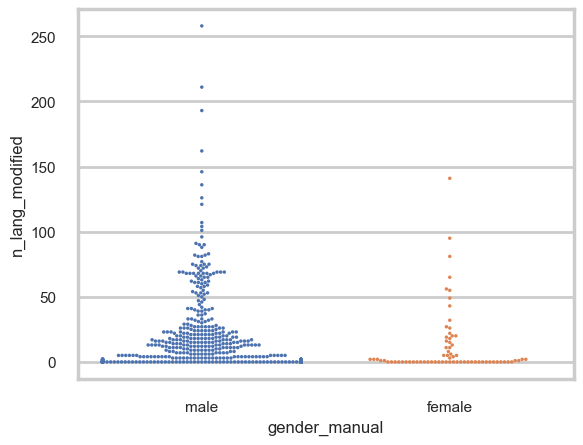

In [44]:
plt.figure(dpi=100)
sns.swarmplot(x='gender_manual', y='n_lang_modified', data=df[df.gender_manual!='mixed'], size=2.5)
plt.show()

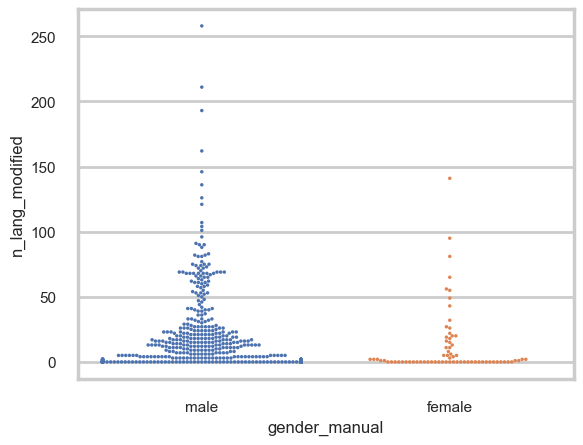

In [45]:
plt.figure(dpi=100)
sns.swarmplot(x='gender_manual', y='n_lang_modified', data=df[df.gender_manual!='mixed'], size=2.5)
plt.show()

In [46]:
df[df.n_lang_modified==0].groupby(['gender_manual','wikidata']).count()['Name']

gender_manual  wikidata
female         N            6
               U           24
               Y            5
male           N           79
               U           86
               Y           11
mixed          U           12
Name: Name, dtype: int64

### df_model1 (gender: male+female)

In [47]:
df_model1 = df[df.gender_manual!='mixed']
#df_model1 = df[(df.gender_manual!='mixed') & (df.wikidata=='Y')]

In [48]:
corr = df_model1['n_lang_modified'].corr(df_model1['n_prop_notability_list_modified'], method='pearson')
corr

0.863732131137911

In [49]:
np.mean(df_model1.n_lang_modified)

17.516351118760756

In [50]:
np.var(df_model1.n_lang_modified)

881.4476672364352

In [51]:
mP = poisson('n_lang_modified ~ \
C(gender_manual, Treatment(reference=\'male\')) + \
C(occupation_level2_modified, Treatment(reference=\'Missing\'))', 
                       data=df_model1)
resP = mP.fit_regularized()
resP.summary2()

Optimization terminated successfully    (Exit mode 0)
            Current function value: 11.152236452358439
            Iterations: 39
            Function evaluations: 42
            Gradient evaluations: 39


<class 'statsmodels.iolib.summary2.Summary'>
"""
                                                         Results: Poisson
==================================================================================================================================
Model:                                     Poisson                               Pseudo R-squared:                      0.412     
Dependent Variable:                        n_lang_modified                       AIC:                                   12978.8988
Date:                                      2023-04-10 23:10                      BIC:                                   13022.5463
No. Observations:                          581                                   Log-Likelihood:                        -6479.4   
Df Model:                                  9                                     LL-Null:                               -11012.   
Df Residuals:                              571                                   LLR p-value:                           0.0000    
Converged:                                 1.0000                                Scale:                                 1.0000    
No. Iterations:                            39.0000                                                                                
----------------------------------------------------------------------------------------------------------------------------------
                                                                                     Coef.  Std.Err.    z    P>|z|   [0.025 0.975]
----------------------------------------------------------------------------------------------------------------------------------
Intercept                                                                           -0.0796   0.0683 -1.1649 0.2441 -0.2135 0.0543
C(gender_manual, Treatment(reference='male'))[T.female]                              0.0217   0.0355  0.6100 0.5418 -0.0479 0.0912
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Academia]            3.9424   0.0942 41.8562 0.0000  3.7578 4.1270
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Administration/Law]  0.7727   0.7104  1.0878 0.2767 -0.6196 2.1651
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Culture-core]        3.8232   0.0873 43.7728 0.0000  3.6520 3.9944
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Family]              3.2295   0.1087 29.7136 0.0000  3.0165 3.4425
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Military]            3.3938   0.1036 32.7621 0.0000  3.1908 3.5968
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Nobility]            3.5899   0.0698 51.4493 0.0000  3.4532 3.7267
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Politics]            4.1571   0.0898 46.3052 0.0000  3.9812 4.3331
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Religious]           3.2368   0.0697 46.4098 0.0000  3.1001 3.3735
==================================================================================================================================

"""

In [52]:
np.sum([p**2 for p in resP.resid_pearson])/resP.df_resid

51.528378361494795

In [53]:
mNB = negativebinomial('n_lang_modified ~ \
C(gender_manual, Treatment(reference=\'male\')) + \
C(occupation_level2_modified, Treatment(reference=\'Missing\'))', 
                       data=df_model1)
resNB = mNB.fit_regularized()
resNB.summary2()

Optimization terminated successfully    (Exit mode 0)
            Current function value: 2.9947478058755244
            Iterations: 67
            Function evaluations: 70
            Gradient evaluations: 67


<class 'statsmodels.iolib.summary2.Summary'>
"""
                                                     Results: NegativeBinomial
===================================================================================================================================
Model:                                    NegativeBinomial                       Pseudo R-squared:                       0.119     
Dependent Variable:                       n_lang_modified                        AIC:                                    3501.8970 
Date:                                     2023-04-10 23:10                       BIC:                                    3549.9092 
No. Observations:                         581                                    Log-Likelihood:                         -1739.9   
Df Model:                                 9                                      LL-Null:                                -1975.7   
Df Residuals:                             571                                    LLR p-value:                            7.2973e-96
Converged:                                1.0000                                 Scale:                                  1.0000    
No. Iterations:                           67.0000                                                                                  
-----------------------------------------------------------------------------------------------------------------------------------
                                                                                     Coef.  Std.Err.    z    P>|z|   [0.025  0.975]
-----------------------------------------------------------------------------------------------------------------------------------
Intercept                                                                           -1.2365   0.1705 -7.2504 0.0000 -1.5708 -0.9023
C(gender_manual, Treatment(reference='male'))[T.female]                              2.1354   0.2299  9.2886 0.0000  1.6848  2.5860
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Academia]            5.0995   0.5852  8.7147 0.0000  3.9526  6.2464
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Administration/Law]  1.9295   1.4403  1.3397 0.1803 -0.8933  4.7524
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Culture-core]        4.9801   0.4746 10.4939 0.0000  4.0500  5.9103
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Family]              4.3865   0.5421  8.0923 0.0000  3.3241  5.4490
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Military]            4.5506   0.5410  8.4113 0.0000  3.4903  5.6110
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Nobility]            4.6987   0.2016 23.3039 0.0000  4.3035  5.0939
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Politics]            5.3139   0.5844  9.0930 0.0000  4.1685  6.4593
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Religious]           4.2956   0.1921 22.3591 0.0000  3.9191  4.6722
alpha                                                                                1.5454   0.1095 14.1076 0.0000  1.3307  1.7601
===================================================================================================================================

"""

### Notability - language editions

In [54]:
expr = 'n_lang_modified ~ \
C(gender_manual, Treatment(\'male\')) + \
C(occupation_level2_modified, Treatment(reference=\'Missing\'))'
y, X = dmatrices(expr, df_model1, return_type='dataframe')
X

df_model1.occupation_level2_modified.value_counts()

zinb = ZeroInflatedNegativeBinomialP(endog=y, exog=X, exog_infl=X.iloc[:, [1,7,9]], inflation='logit',)

zinb_results = zinb.fit_regularized()
zinb_results.summary2()

Optimization terminated successfully    (Exit mode 0)
            Current function value: 2.947111740954004
            Iterations: 105
            Function evaluations: 106
            Gradient evaluations: 105


<class 'statsmodels.iolib.summary2.Summary'>
"""
                                                  Results: ZeroInflatedNegativeBinomialP
==========================================================================================================================================
Model:                                   ZeroInflatedNegativeBinomialP                    Pseudo R-squared:                    0.125      
Dependent Variable:                      n_lang_modified                                  AIC:                                 3444.5438  
Date:                                    2023-04-10 23:10                                 BIC:                                 3488.1914  
No. Observations:                        581                                              Log-Likelihood:                      -1712.3    
Df Model:                                9                                                LL-Null:                             -1957.9    
Df Residuals:                            571                                              LLR p-value:                         4.2073e-100
Converged:                               1.0000                                           Scale:                               1.0000     
No. Iterations:                          105.0000                                                                                         
------------------------------------------------------------------------------------------------------------------------------------------
                                                                                     Coef.    Std.Err.    z    P>|z|    [0.025     0.975] 
------------------------------------------------------------------------------------------------------------------------------------------
inflate_C(gender_manual, Treatment('male'))[T.female]                                 1.2880    0.4421  2.9135 0.0036     0.4215    2.1544
inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Nobility]   -18.4763  820.6607 -0.0225 0.9820 -1626.9417 1589.9891
inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Religious]  -20.3675 3688.6624 -0.0055 0.9956 -7250.0129 7209.2778
Intercept                                                                            -0.0418    0.2351 -0.1779 0.8588    -0.5026    0.4190
C(gender_manual, Treatment('male'))[T.female]                                         1.6270    0.2758  5.9003 0.0000     1.0866    2.1675
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Academia]             3.9047    0.5586  6.9903 0.0000     2.8099    4.9996
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Administration/Law]   0.7349    1.3483  0.5451 0.5857    -1.9077    3.3775
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Culture-core]         3.7854    0.4648  8.1436 0.0000     2.8744    4.6965
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Family]               3.1918    0.5224  6.1101 0.0000     2.1679    4.2156
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Military]             3.3560    0.5213  6.4375 0.0000     2.3342    4.3777
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Nobility]             3.5084    0.2530 13.8652 0.0000     3.0124    4.0043
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Politics]             4.1193    0.5578  7.3844 0.0000     3.0260    5.2126
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Religious]            3.1100    0.2453 12.6766 0.0000     2.6292    3.5909
alpha                                                                                 1.2627    0.0901 14.0141 0.0000     1.0861    1.4393
==========================================================================================================================================

"""

In [55]:
a = zinb_results.summary2(float_format='%.4f').tables[1].iloc[:,:-2]
a.insert(loc=1, column='IRR' , value=['' for i in range(len(a))])
a['IRR'] = np.exp(a['Coef.'])
a

,Coef.,IRR,Std.Err.,z,P>|z|
"inflate_C(gender_manual, Treatment('male'))[T.female]",1.287961,3.625387e+00,0.442072,2.913465,3.574415e-03
"inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Nobility]",-18.476310,9.458901e-09,820.660712,-0.022514,9.820380e-01
"inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Religious]",-20.367540,1.427216e-09,3688.662367,-0.005522,9.955944e-01
Intercept,-0.041830,9.590327e-01,0.235111,-0.177917,8.587885e-01
"C(gender_manual, Treatment('male'))[T.female]",1.627037,5.088777e+00,0.275754,5.900313,3.628117e-09
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Academia]",3.904731,4.963671e+01,0.558596,6.990261,2.743744e-12
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Administration/Law]",0.734917,2.085308e+00,1.348298,0.545070,5.857054e-01
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Culture-core]",3.785441,4.405511e+01,0.464834,8.143648,3.835438e-16
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Family]",3.191758,2.433117e+01,0.522373,6.110112,9.956151e-10
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Military]",3.355967,2.867332e+01,0.521317,6.437473,1.214788e-10


In [56]:
pd.set_option('display.max_colwidth', 100)
pd.set_option('display.max_rows', None)
print(a.to_latex(float_format='%.4f'))

\begin{tabular}{lrrrrr}
\toprule
{} &    Coef. &     IRR &  Std.Err. &       z &  P>|z| \\
\midrule
inflate\_C(gender\_manual, Treatment('male'))[T.female]                               &   1.2880 &  3.6254 &    0.4421 &  2.9135 & 0.0036 \\
inflate\_C(occupation\_level2\_modified, Treatment(reference='Missing'))[T.Nobility]   & -18.4763 &  0.0000 &  820.6607 & -0.0225 & 0.9820 \\
inflate\_C(occupation\_level2\_modified, Treatment(reference='Missing'))[T.Religious]  & -20.3675 &  0.0000 & 3688.6624 & -0.0055 & 0.9956 \\
Intercept                                                                           &  -0.0418 &  0.9590 &    0.2351 & -0.1779 & 0.8588 \\
C(gender\_manual, Treatment('male'))[T.female]                                       &   1.6270 &  5.0888 &    0.2758 &  5.9003 & 0.0000 \\
C(occupation\_level2\_modified, Treatment(reference='Missing'))[T.Academia]           &   3.9047 & 49.6367 &    0.5586 &  6.9903 & 0.0000 \\
C(occupation\_level2\_modified, Treatment(reference='Mi

### Notability - identifiers that suggest notability

In [57]:
expr = 'n_prop_notability_list_modified ~ \
C(gender_manual, Treatment(\'male\')) + \
C(occupation_level2_modified, Treatment(reference=\'Missing\'))'
y, X = dmatrices(expr, df_model1, return_type='dataframe')
X

df_model1.occupation_level2_modified.value_counts()

zinb = ZeroInflatedNegativeBinomialP(endog=y, exog=X.iloc[:, :], exog_infl=X.iloc[:, [1,7,8,9]], inflation='logit')

zinb_results = zinb.fit_regularized()
zinb_results.summary2()

Optimization terminated successfully    (Exit mode 0)
            Current function value: 1.70588345426633
            Iterations: 140
            Function evaluations: 141
            Gradient evaluations: 140


<class 'statsmodels.iolib.summary2.Summary'>
"""
                                                  Results: ZeroInflatedNegativeBinomialP
==========================================================================================================================================
Model:                                  ZeroInflatedNegativeBinomialP                      Pseudo R-squared:                    0.142     
Dependent Variable:                     n_prop_notability_list_modified                    AIC:                                 2002.2366 
Date:                                   2023-04-10 23:10                                   BIC:                                 2045.8841 
No. Observations:                       581                                                Log-Likelihood:                      -991.12   
Df Model:                               9                                                  LL-Null:                             -1155.3   
Df Residuals:                           571                                                LLR p-value:                         2.4696e-65
Converged:                              1.0000                                             Scale:                               1.0000    
No. Iterations:                         140.0000                                                                                          
------------------------------------------------------------------------------------------------------------------------------------------
                                                                                     Coef.    Std.Err.    z    P>|z|    [0.025     0.975] 
------------------------------------------------------------------------------------------------------------------------------------------
inflate_C(gender_manual, Treatment('male'))[T.female]                                 1.0367    0.6782  1.5285 0.1264    -0.2926    2.3659
inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Nobility]   -19.8269 3706.7670 -0.0053 0.9957 -7284.9568 7245.3029
inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Politics]    -2.4743    3.0337 -0.8156 0.4147    -8.4201    3.4716
inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Religious]   -2.7388    0.8033 -3.4093 0.0007    -4.3133   -1.1643
Intercept                                                                            -1.3646    0.2419 -5.6417 0.0000    -1.8386   -0.8905
C(gender_manual, Treatment('male'))[T.female]                                         0.5578    0.2576  2.1652 0.0304     0.0529    1.0627
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Academia]             3.7805    0.5383  7.0226 0.0000     2.7254    4.8356
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Administration/Law]   1.3645    1.4580  0.9359 0.3493    -1.4931    4.2221
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Culture-core]         3.6796    0.4519  8.1417 0.0000     2.7938    4.5653
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Family]               2.0067    0.6070  3.3060 0.0009     0.8170    3.1964
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Military]             2.6082    0.5705  4.5716 0.0000     1.4900    3.7264
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Nobility]             2.7865    0.2589 10.7649 0.0000     2.2792    3.2939
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Politics]             3.3325    0.5987  5.5658 0.0000     2.1590    4.5060
C(occupation_level2_modified, Treatment(reference='Missing'))[T.Religious]            2.8907    0.2600 11.1181 0.0000     2.3811    3.4003
alpha                                                                                 1.0672    0.1378  7.7453 0.0000     0.7972    1.3373
=============================================================================================================

In [58]:
a = zinb_results.summary2(float_format='%.4f').tables[1].iloc[:,:-2]
a.insert(loc=1, column='IRR' , value=['' for i in range(len(a))])
a['IRR'] = np.exp(a['Coef.'])
a

,Coef.,IRR,Std.Err.,z,P>|z|
"inflate_C(gender_manual, Treatment('male'))[T.female]",1.036650,2.819756e+00,0.678196,1.528541,1.263782e-01
"inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Nobility]",-19.826949,2.450560e-09,3706.767021,-0.005349,9.957323e-01
"inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Politics]",-2.474280,8.422363e-02,3.033652,-0.815611,4.147227e-01
"inflate_C(occupation_level2_modified, Treatment(reference='Missing'))[T.Religious]",-2.738808,6.464734e-02,0.803330,-3.409321,6.512480e-04
Intercept,-1.364556,2.554940e-01,0.241870,-5.641682,1.683966e-08
"C(gender_manual, Treatment('male'))[T.female]",0.557783,1.746796e+00,0.257609,2.165231,3.037002e-02
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Academia]",3.780471,4.383670e+01,0.538331,7.022575,2.178162e-12
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Administration/Law]",1.364533,3.913895e+00,1.457979,0.935907,3.493208e-01
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Culture-core]",3.679565,3.962914e+01,0.451938,8.141741,3.896327e-16
"C(occupation_level2_modified, Treatment(reference='Missing'))[T.Family]",2.006725,7.438914e+00,0.606999,3.305977,9.464587e-04


In [59]:
pd.set_option('display.max_colwidth', 100)
pd.set_option('display.max_rows', None)
print(a.to_latex(float_format='%.4f',))

\begin{tabular}{lrrrrr}
\toprule
{} &    Coef. &     IRR &  Std.Err. &       z &  P>|z| \\
\midrule
inflate\_C(gender\_manual, Treatment('male'))[T.female]                               &   1.0367 &  2.8198 &    0.6782 &  1.5285 & 0.1264 \\
inflate\_C(occupation\_level2\_modified, Treatment(reference='Missing'))[T.Nobility]   & -19.8269 &  0.0000 & 3706.7670 & -0.0053 & 0.9957 \\
inflate\_C(occupation\_level2\_modified, Treatment(reference='Missing'))[T.Politics]   &  -2.4743 &  0.0842 &    3.0337 & -0.8156 & 0.4147 \\
inflate\_C(occupation\_level2\_modified, Treatment(reference='Missing'))[T.Religious]  &  -2.7388 &  0.0646 &    0.8033 & -3.4093 & 0.0007 \\
Intercept                                                                           &  -1.3646 &  0.2555 &    0.2419 & -5.6417 & 0.0000 \\
C(gender\_manual, Treatment('male'))[T.female]                                       &   0.5578 &  1.7468 &    0.2576 &  2.1652 & 0.0304 \\
C(occupation\_level2\_modified, Treatment(reference='M

## RQ2: Asymmetries in Content building

In [60]:
props = ['gender','occupation','religion', 'date_of_birth', 'date_of_death',\
         'place_of_birth', 'place_of_death', 'spouse', 'child', 'father', 'mother']
pd.DataFrame(df_Q.notna().sum()).loc[props,:]

,0
gender,386
occupation,332
religion,178
date_of_birth,300
date_of_death,325
place_of_birth,176
place_of_death,200
spouse,95
child,119
father,165


In [61]:
props = ['gender','occupation','religion', 'date_of_birth', 'date_of_death',\
         'place_of_birth', 'place_of_death', 'spouse', 'child', 'father', 'mother']

df_cmplt = pd.DataFrame(df_Q.notna().sum()).loc[props,:]
df_cmplt = pd.concat([df_cmplt.rename(columns={0:'All'}),\
                      df_cmplt.rename(columns={0:'All p'})/len(df_Q)], axis=1, )

df_cmplt_f = pd.DataFrame(df_Q[df_Q.gender=='female'].notna().sum()).loc[props,:]
df_cmplt_f = pd.concat([df_cmplt_f.rename(columns={0:'female'}), \
                        df_cmplt_f.rename(columns={0:'female p'})/len(df_Q[df_Q.gender=='female'])], axis=1, )

df_cmplt_m = pd.DataFrame(df_Q[df_Q.gender=='male'].notna().sum()).loc[props,:]
df_cmplt_m = pd.concat([df_cmplt_m.rename(columns={0:'male'}), \
                        df_cmplt_m.rename(columns={0:'male p'})/len(df_Q[df_Q.gender=='male'])], axis=1, )


df_cmplt = pd.concat([df_cmplt, df_cmplt_f, df_cmplt_m], axis=1, )
df_cmplt.columns = pd.MultiIndex.from_product([['All genders','Female', 'Male'],\
                                            ['count', 'percentage']])

df_cmplt.insert(len(df_cmplt.columns),('Chi-square', 'stat'), '-')
df_cmplt.insert(len(df_cmplt.columns),('Chi-square', 'p'),'-')

#Chi-square

F = len(df_Q[df_Q.gender=='female'])
M = len(df_Q[df_Q.gender=='male'])
for prop in df_cmplt.index[1:]:
    f = df_cmplt.at[prop, ('Female','count')]
    m = df_cmplt.at[prop, ('Male','count')]
    table = [[f,F-f], [m,M-m]]
    stat, p, dof, expected = chi2_contingency(table)
    df_cmplt.at[prop, ('Chi-square','stat')] = stat
    df_cmplt.at[prop, ('Chi-square','p')] = p

#format

df_cmplt = df_cmplt.style.format({
    ('All genders','percentage'): "{:.2%}", \
    ('Female','percentage'): "{:.2%}", \
    ('Male','percentage'): "{:.2%}",\
    #('Chi-square','stat'): "{:.2f}", \
    #('Chi-square','p'): "{:.4f}", 
})
df_cmplt

In [62]:
print(df_cmplt.to_latex())

\begin{tabular}{lrrrrrrll}
 & \multicolumn{2}{r}{All genders} & \multicolumn{2}{r}{Female} & \multicolumn{2}{r}{Male} & \multicolumn{2}{r}{Chi-square} \\
 & count & percentage & count & percentage & count & percentage & stat & p \\
gender & 386 & 99.74% & 42 & 100.00% & 344 & 100.00% & - & - \\
occupation & 332 & 85.79% & 25 & 59.52% & 307 & 89.24% & 25.062666 & 0.000001 \\
religion & 178 & 45.99% & 12 & 28.57% & 166 & 48.26% & 5.071258 & 0.024326 \\
date_of_birth & 300 & 77.52% & 28 & 66.67% & 272 & 79.07% & 2.647627 & 0.103705 \\
date_of_death & 325 & 83.98% & 26 & 61.90% & 299 & 86.92% & 15.771483 & 0.000071 \\
place_of_birth & 176 & 45.48% & 23 & 54.76% & 153 & 44.48% & 1.208494 & 0.271630 \\
place_of_death & 200 & 51.68% & 23 & 54.76% & 177 & 51.45% & 0.058335 & 0.809148 \\
spouse & 95 & 24.55% & 24 & 57.14% & 71 & 20.64% & 24.949472 & 0.000001 \\
child & 119 & 30.75% & 20 & 47.62% & 99 & 28.78% & 5.377978 & 0.020393 \\
father & 165 & 42.64% & 26 & 61.90% & 139 & 40.41% & 6.217049

## RQ3 Asymmetries in  Structural Placement

### Graph construction

In [63]:
edges = []
for i in range(len(df)):
    out = df.at[i,'Outlinks']
    inl = df.at[i,'Inlinks']
    
    if type(out)==str:
        df.at[i,'Outlinks'] = ast.literal_eval(out)
        out = list(df.at[i,'Outlinks'].keys())
        for j in range(len(out)):
            edges.append((df.at[i, 'Wikidata_Q'], out[j]))
    if type(inl)==str:
        df.at[i,'Inlinks'] = ast.literal_eval(inl)
        inl = list(df.at[i,'Inlinks'].keys())
        for j in range(len(inl)):
            edges.append((inl[j], df.at[i, 'Wikidata_Q']))
edges = [(u,v) for (u,v) in edges if u!=v]
len(edges)

36069

In [64]:
G = nx.DiGraph()
G.add_nodes_from(list(df.Wikidata_Q.dropna()))
G.add_edges_from(edges)
print(G.number_of_nodes(), G.number_of_edges())

11293 33961


In [65]:
nodes = list(df_Q.Wikidata_Q)
edges_reduced = [(u,v) for (u,v) in edges if (u in nodes and v in nodes and u!=v)]
len(edges_reduced)

4365

In [66]:
G = nx.DiGraph()
G.add_nodes_from(list(df.Wikidata_Q.dropna()))
G.add_edges_from(edges_reduced)
print(G.number_of_nodes(), G.number_of_edges())

387 2257


In [67]:
df_name = df[['Wikidata_Q', 'Name']].dropna()
name_dict = df_name.set_index('Wikidata_Q').to_dict()['Name']

In [68]:
degree_new = [(name_dict[q],q,n) for (q,n) in sorted(G.degree, key=lambda x: x[1], reverse=True)]
degree_new[:5]

[('Bede', 'Q154938', 195),
 ('Wilfrid', 'Q719721', 90),
 ('Edwin', 'Q348955', 63),
 ('Oswiu', 'Q468847', 54),
 ('Penda', 'Q332123', 54)]

In [69]:
Gcc = sorted(nx.weakly_connected_components(G), key=len, reverse=True)
G0 = G.subgraph(Gcc[0])
len(G0.nodes)

344

### women network

In [70]:
gender_dict = dict()
occ_dict = dict()
for node in G.nodes:
    gender_dict.update({node:list(df[df.Wikidata_Q==node].gender_manual)[0]})
    occ_dict.update({node:list(df[df.Wikidata_Q==node].occupation_level2_modified)[0]})
nx.set_node_attributes(G, gender_dict, 'gender')
nx.set_node_attributes(G, occ_dict, 'occ')

In [71]:
nx.set_node_attributes(G, name_dict, 'name')

In [72]:
women_list = []
for i,j,k in degree_new:
    if list(df[df.Name==i].gender_manual)[0] == 'female':
        women_list.append(j)
        print(i,k,end='\t')

Hild 34	Eanflaed 31	Hereswith 22	Etheldreda 20	Osthryth 19	Aebbe 19	Seaxburh 18	Mary 18	Placidia 17	Aelfflaed 15	Bertha 14	Helena 12	Ethelburh of Northumbria 12	Acha 12	Baldhild 10	Fara 6	Ethelburh of Barking 5	Helen 5	Thecla 5	Saethryth 4	Hildelith 4	Cecilia 4	Ethelburh of East Anglia 3	Agatha 2	Agnes 2	Eve 2	Begu 2	Plectrudis 2	Eulalia 1	Euphemia 1	Heiu 1	Ricule 0	Cwenburh 0	Ethelthryth of Northumbria 0	Bebbe 0	Eorcengota 0	Abbess Ethelhild 0	Alhflaed 0	Cyneburh 0	Cynewise 0	Priscilla 0	Eafe 0	

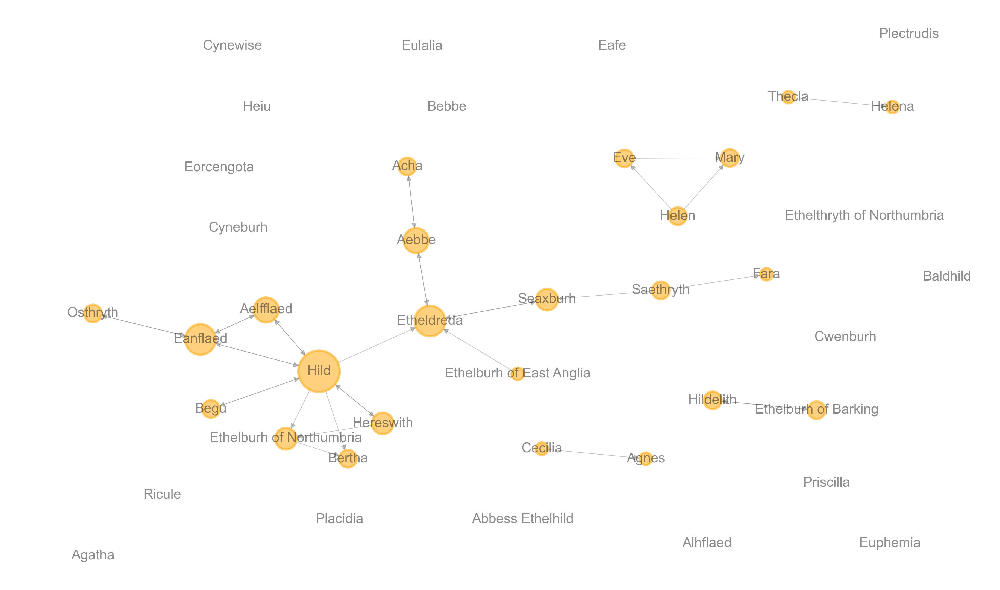

In [73]:
G1 = G.subgraph(women_list)
women_name_dict = {u:v for u,v in name_dict.items() if u in women_list}
plt.figure(figsize=[12,7],dpi=300)
pos=nx.nx_agraph.graphviz_layout(G1,)

node_options = {'node_color': 'orange', 'node_size': [G1.degree[v]*120 for v in G1]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(G1,pos, labels = women_name_dict, with_labels = True, **node_options, **edge_options)
#nx.draw(G1,pos, labels = women_name_dict, with_labels = True,)
plt.show()
#plt.savefig('1.png', )

In [74]:
print(G1.number_of_nodes(), G1.number_of_edges())

42 33


In [75]:
degree_new = [(name_dict[q],q,n) for (q,n) in sorted(G1.degree, key=lambda x: x[1], reverse=True)]
for i,j,k in degree_new:
    print(i,k,end='\t')

Hild 11	Etheldreda 6	Eanflaed 6	Aelfflaed 4	Aebbe 4	Seaxburh 3	Ethelburh of Northumbria 3	Hereswith 3	Hildelith 2	Begu 2	Bertha 2	Eve 2	Helen 2	Acha 2	Mary 2	Ethelburh of Barking 2	Saethryth 2	Osthryth 2	Cecilia 1	Agnes 1	Thecla 1	Ethelburh of East Anglia 1	Fara 1	Helena 1	Eulalia 0	Heiu 0	Cyneburh 0	Plectrudis 0	Agatha 0	Baldhild 0	Priscilla 0	Eorcengota 0	Euphemia 0	Cwenburh 0	Eafe 0	Cynewise 0	Ethelthryth of Northumbria 0	Abbess Ethelhild 0	Alhflaed 0	Ricule 0	Placidia 0	Bebbe 0	

### exclude male only edges

In [76]:
women_involved_edges = [(u,v) for (u,v) in G.edges if (u in women_list or v in women_list)]
len(women_involved_edges)

289

In [77]:
women_involved_nodes = list(set(np.array(women_involved_edges).flatten()))
len(women_involved_nodes)

133

In [78]:
women_name_dict = {u:v for u,v in name_dict.items() if u in women_list}

In [79]:
G2 = G.subgraph(women_involved_nodes)
#G2 = G2.to_undirected()

In [80]:
color_map = []
name_dict_G2 = dict()
for node in G2.nodes:
    if node in women_list:
        color_map.append('orange')
        name_dict_G2.update({node:name_dict[node]})
    else:
        color_map.append('grey')
        name_dict_G2.update({node:''})



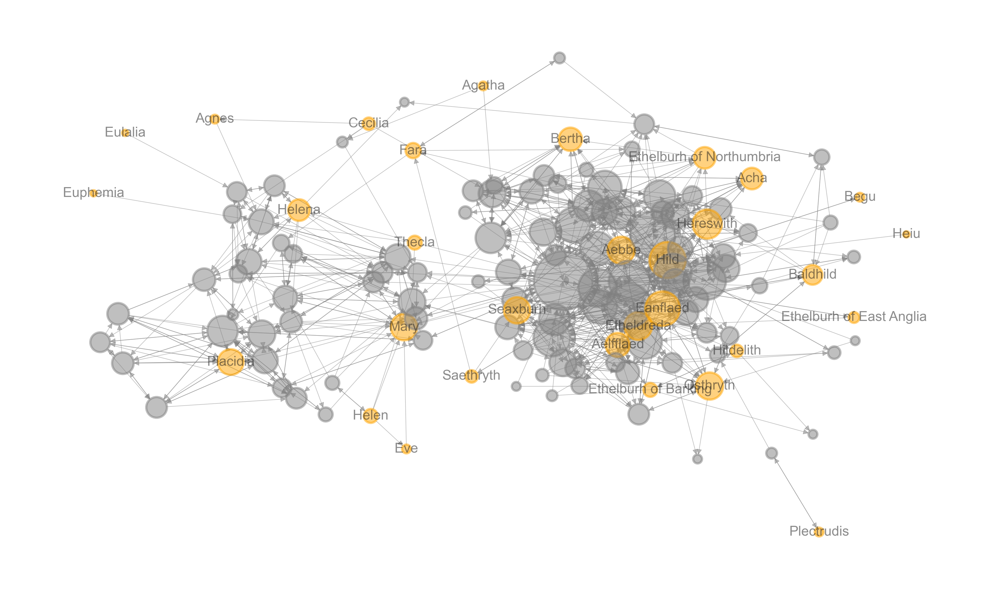

In [81]:
pos=nx.nx_agraph.graphviz_layout(G2,)
plt.figure(figsize=[12,7],dpi=300)
node_options = {'node_color': color_map, 'node_size': [G2.degree[v]*30 for v in G2]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(G2,pos, labels = name_dict_G2, with_labels = True, **node_options, **edge_options)
#plt.axis("equal")
plt.show()
#plt.savefig('1.png', )

In [82]:
degree_new = [(name_dict[q],q,n) for (q,n) in sorted(G2.degree, key=lambda x: x[1], reverse=True)]
for i,j,k in degree_new:
    print(i,k,end='\t')

Bede 90	Edwin 52	Wilfrid 51	Anna 44	Oswiu 38	Penda 37	Oswald 37	Ecgfrith 35	Hild 34	Ethelred of Mercia 31	Eadbald 31	Eanflaed 31	Aethelwold 30	Wulfhere 30	Raedwald 29	Paulinus 27	Sigeberht 26	Aldfrith 25	Ethelberht of Kent 25	Theodosius the younger 24	Augustine of Canterbury 24	Hereswith 22	Etheldreda 20	Ecgric 20	Theodore of Canterbury 19	Aebbe 19	Osthryth 19	Eni 19	Caedwalla 19	Theodosius 19	Ealdwulf 19	Paul 19	Gregory the Great 19	Mary 18	Seaxburh 18	Eusebius 17	Placidia 17	Constantine 17	Honorius 17	Ethelfrith of Northumbria 17	Ethelhere 16	Chad 16	Cuthbert 16	Cedd 16	Eorcenberht 16	Diocletian 16	Mellitus 15	Aidan 15	Jesus 15	Aelfflaed 15	Eddi Stephen 15	Bertha 14	Egbert of Kent 14	Eanfrith of Northumbria 13	Augustine of Hippo 13	Maximus 13	Acha 12	Theodoret of Cyrrus 12	Ethelburh of Northumbria 12	Helena 12	Ricberht 12	Aetius 12	Alaric 12	Aelle 11	Valentinian III 11	James the Deacon 11	Arcadius 11	Constantius 11	Evangelist John 11	Eutropius 11	Elfwine 11	Laurence 11	Bosa 10	Hlothh

### Reciprocity

### Communicability

In [83]:
def cal_comm_ud(G):
    G = G.to_undirected()
    comms = nx.communicability_exp(G)
    comm = {i:sum(j.values()) for i,j in comms.items()}
    return {i:j/np.max(list(comm.values())) for i,j in comm.items()}

In [84]:
def cal_comm_in(G):
    A = nx.adjacency_matrix(G)
    lam = max(np.linalg.eigvals(A.todense()))
    I = np.identity(len(G.nodes))
    C = np.linalg.solve(I-1/lam * A, I)
    comm = list(np.sum(C, axis=1,))
    comm = comm/max(comm)
    return {j:comm[i] for i,j in enumerate(G.nodes)}

In [85]:
def cal_comm_out(G):
    A = nx.adjacency_matrix(G)
    lam = max(np.linalg.eigvals(A.todense()))
    I = np.identity(len(G.nodes))
    C = np.linalg.solve(I-1/lam * A, I)
    comm = list(np.sum(C, axis=0,))
    comm = comm/max(comm)
    return {j:comm[i] for i,j in enumerate(G.nodes)}

In [86]:
comm_ud = cal_comm_ud(G)
comm_ud['Q729480']

0.0638809197739509

In [87]:
comm_in = cal_comm_in(G)
comm_in['Q729480']

(0.04985917412460854+0j)

In [88]:
comm_out = cal_comm_out(G)
comm_out['Q729480']

(0.08904213341476025+0j)

In [89]:
nx.set_node_attributes(G,comm_ud,'comm_ud')
nx.set_node_attributes(G,comm_in,'comm_in')
nx.set_node_attributes(G,comm_out,'comm_out')

### Entropy change

In [90]:
def cal_entr_change(G, node):
    H = G.copy()
    comm = cal_comm_ud(H)
    pk = [c/sum(comm.values()) for c in comm.values()]
    S0 = entropy(pk)
    
    H.remove_node(node,)
    comm = cal_comm_ud(H)
    pk = [c/sum(comm.values()) for c in comm.values()]
    S = entropy(pk,)
    
    return (S0-S)/S0

In [91]:
%%time
importance = {j:cal_entr_change(G, j) for i,j in enumerate(G.nodes)}

CPU times: user 11min 51s, sys: 3min 49s, total: 15min 40s
Wall time: 2min 35s


In [92]:
nx.set_node_attributes(G,importance,'impr')

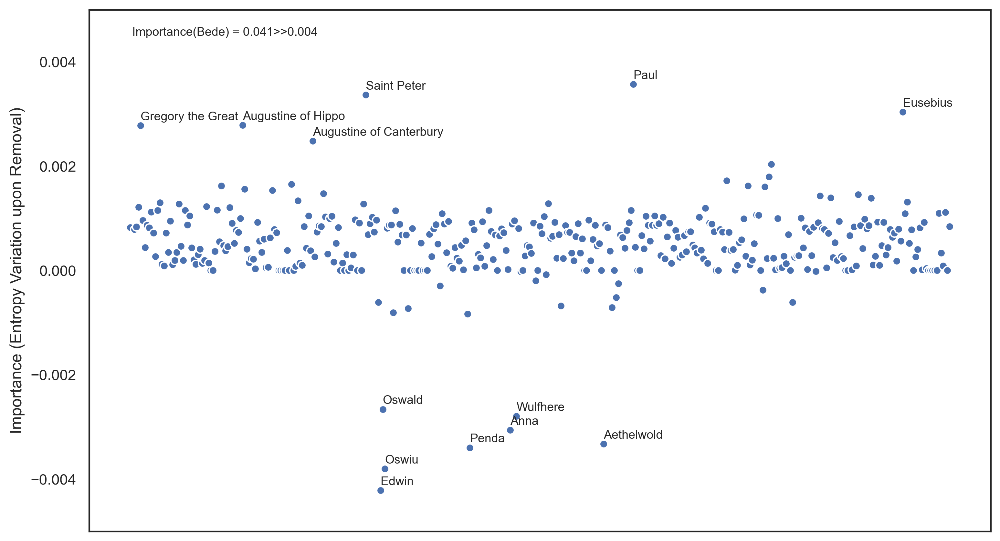

In [93]:
sns.set_theme(style='white')
plt.figure(figsize=[12,7],dpi=300)
colors = []
for node in importance.keys():
    if gender_dict[node] == 'male':
        colors.append('grey')
    else:
        colors.append('orange')
sns.scatterplot(data=importance, linewidth=1, palette=colors)
for i,v in importance.items():
    if abs(v) >0.0022:
        plt.annotate(G.nodes[i]['name'],xy=(i, v), xytext=(i, v+0.0001),fontsize=9)
plt.ylim(-0.005,0.005)
plt.annotate('Importance(Bede) = 0.041>>0.004',xy=('Q154938', 0.0045), xytext=('Q154938', 0.0045),fontsize=9,)
plt.xticks([])
plt.ylabel('Importance (Entropy Variation upon Removal)')
plt.savefig('pic/3-importance.png', bbox_inches = 'tight')
plt.show()

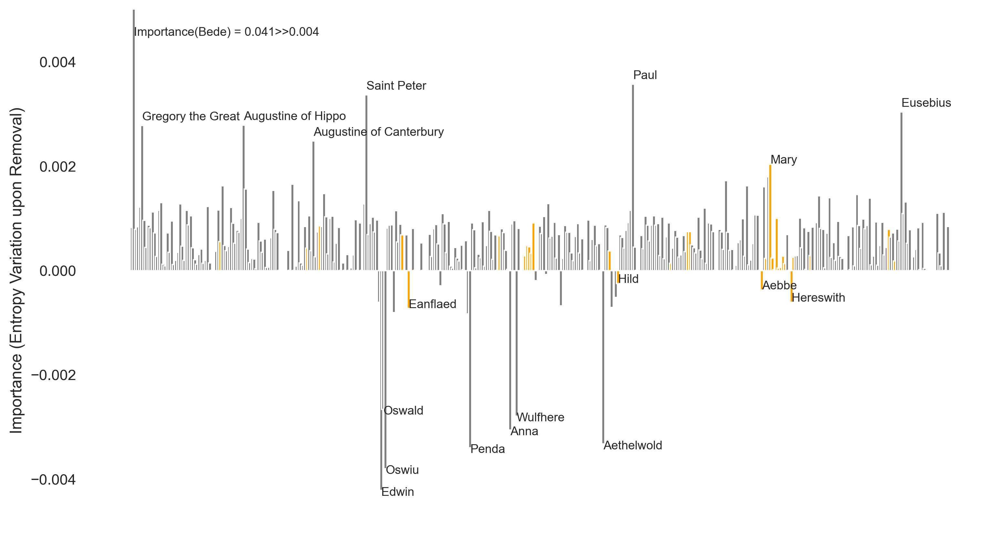

In [94]:
sns.set_theme(style='white')
plt.figure(figsize=[12,7],dpi=300)
colors = []
for node in importance.keys():
    if gender_dict[node] == 'male':
        colors.append('grey')
    else:
        colors.append('orange')

plt.bar(importance.keys(),importance.values(),width=1.5,color=colors)

for i,v in importance.items():
    if abs(v) >0.0022:
        if v>0:
            plt.annotate(G.nodes[i]['name'],xy=(i, v), xytext=(i, v+0.0001),fontsize=9)
        else:
            plt.annotate(G.nodes[i]['name'],xy=(i, v), xytext=(i, v-0.0001),fontsize=9)
    if gender_dict[i] =='female' and (v >0.001 or v<-0.0002):
        plt.annotate(G.nodes[i]['name'],xy=(i, v), xytext=(i, v+0.00001),fontsize=9)
plt.ylim(-0.005,0.005)
plt.annotate('Importance(Bede) = 0.041>>0.004',xy=('Q154938', 0.0045), xytext=('Q154938', 0.0045),fontsize=9,)
plt.xticks([])
plt.ylabel('Importance (Entropy Variation upon Removal)')
plt.box(False)

plt.savefig('pic/3-importance.png', bbox_inches = 'tight')
plt.show()

In [95]:
impr_sort = sorted(importance.items(), key=lambda x: abs(x[1]), reverse=True)

In [96]:
df_impr = pd.DataFrame(impr_sort,columns = ['Wikidata_Q', 'Importance']).set_index('Wikidata_Q')

df_impr['Name'] = name_dict
df_impr['Gender'] = gender_dict
df_impr['Communicability'] = comm_ud

In [97]:
df_impr.head(3)

,Importance,Name,Gender,Communicability
Wikidata_Q,,,,
Q154938,0.041052,Bede,male,1.000000
Q348955,-0.004217,Edwin,male,0.449374
Q468847,-0.003798,Oswiu,male,0.455677


In [98]:
df_impr.sort_values('Communicability', ascending=False).head(3)

,Importance,Name,Gender,Communicability
Wikidata_Q,,,,
Q154938,0.041052,Bede,male,1.000000
Q719721,-0.000079,Wilfrid,male,0.472594
Q468847,-0.003798,Oswiu,male,0.455677


In [99]:
df_impr[df_impr.Gender == 'female']

,Importance,Name,Gender,Communicability
Wikidata_Q,,,,
Q345,2.039541e-03,Mary,female,8.429299e-02
Q51885,9.959512e-04,Thecla,female,5.067467e-02
Q442515,9.095138e-04,Osthryth,female,1.182196e-01
Q238352,8.582037e-04,Bertha,female,8.477347e-02
Q237750,7.891778e-04,Baldhild,female,5.846999e-02
Q3059269,7.439768e-04,Ethelburh of Barking,female,4.639664e-02
Q16239923,7.439768e-04,Hildelith,female,4.639664e-02
Q291529,-7.276083e-04,Eanflaed,female,2.630531e-01
Q2266026,6.846379e-04,Ethelburh of Northumbria,female,1.128229e-01


### independent communicability

In [100]:
df_comm = df_impr.sort_values(by='Communicability', ascending=False)
df_comm.head(30)

,Importance,Name,Gender,Communicability
Wikidata_Q,,,,
Q154938,0.041052,Bede,male,1.000000
Q719721,-0.000079,Wilfrid,male,0.472594
Q468847,-0.003798,Oswiu,male,0.455677
Q348955,-0.004217,Edwin,male,0.449374
Q164499,-0.002791,Wulfhere,male,0.410664
Q332123,-0.003396,Penda,male,0.405666
Q272275,-0.003327,Aethelwold,male,0.399625
Q336016,-0.002659,Oswald,male,0.394674
Q559247,-0.003057,Anna,male,0.382649


In [101]:
df_case = pd.DataFrame(G.nodes(data='comm_ud'), columns = ['Wikidata_Q', 'Communicability']).set_index('Wikidata_Q')

df_case['Name'] = name_dict

In [102]:
df_case.head(10)

,Communicability,Name
Wikidata_Q,,
Q729480,0.063881,Ceolwulf
Q154938,1.000000,Bede
Q16002399,0.060504,Albinus
Q504529,0.275690,Theodore of Canterbury
Q1274084,0.109456,Hadrian
Q42827,0.188721,Gregory the Great
Q1392362,0.066899,Nothhelm
Q103321,0.018223,Gregory II
Q5219187,0.062057,Daniel


In [103]:
%%time

#df_case = df_comm[['Name','Communicability']]

l = df_comm[df_comm.Gender == 'female'].head(10).index
influ_l = []

for i in df_case.index:
    H = G.copy()
    H.remove_node(i)
    comm = cal_comm_ud(H)
    for j in l:
        name = name_dict[j]
        if i == j:
            df_case.at[i,name] = comm_ud[j]
        else: 
            df_case.at[i,name] = comm[j]
            if abs(comm_ud[j] - comm[j])>0.008 and j in l[:2]:
                influ_l.append((i,j,comm_ud[j]))

df_case.head(10)

CPU times: user 5min 32s, sys: 1min 43s, total: 7min 15s
Wall time: 1min 15s


,Communicability,Name,Hild,Eanflaed,Hereswith,Aebbe,Etheldreda,Seaxburh,Aelfflaed,Osthryth,Ethelburh of Northumbria,Acha
Wikidata_Q,,,,,,,,,,,,
Q729480,0.063881,Ceolwulf,0.277875,0.263755,0.241230,0.224336,0.204128,0.185784,0.176829,0.118619,0.113262,0.086921
Q154938,1.000000,Bede,0.557256,0.545288,0.482401,0.455317,0.394275,0.343924,0.326973,0.287422,0.272708,0.215727
Q16002399,0.060504,Albinus,0.277840,0.263842,0.241172,0.224299,0.204184,0.185602,0.176937,0.118601,0.113239,0.086908
Q504529,0.275690,Theodore of Canterbury,0.282371,0.266504,0.248054,0.226932,0.203889,0.175005,0.176215,0.117615,0.117250,0.088862
Q1274084,0.109456,Hadrian,0.278749,0.264868,0.242281,0.225220,0.204857,0.185835,0.177517,0.119075,0.113804,0.087378
Q42827,0.188721,Gregory the Great,0.278485,0.265904,0.241059,0.226758,0.206178,0.186850,0.179502,0.120796,0.111701,0.087727
Q1392362,0.066899,Nothhelm,0.278022,0.264047,0.241291,0.224484,0.204374,0.185877,0.177117,0.118734,0.113258,0.086977
Q103321,0.018223,Gregory II,0.277054,0.263089,0.240465,0.223669,0.203657,0.185255,0.176497,0.118229,0.112846,0.086613
Q5219187,0.062057,Daniel,0.277913,0.263902,0.241226,0.224346,0.204252,0.185775,0.176983,0.118633,0.113260,0.086927


In [104]:
influ_l = list(set([i for i,_,_ in influ_l]))

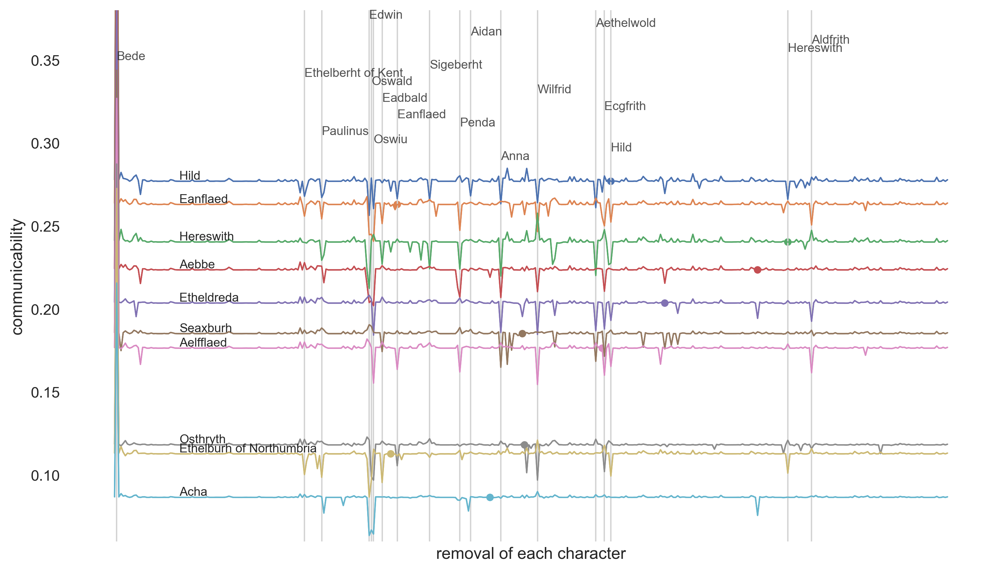

In [105]:
sns.set_theme(style='white')
plt.figure(figsize=[12,7],dpi=300)

sns.lineplot(data=df_case.iloc[:,2:],dashes=False,linewidth = 1,legend= False)

x = df_comm[df_comm.Gender == 'female'].head(10).index
y = [comm_ud[i] for i in x]
plt.scatter(x, y, marker='o', s=20, color=sns.color_palette())
for i in x:
    plt.annotate(G.nodes[i]['name'],xy=(30, comm_ud[i]), xytext=(30, comm_ud[i]+0.001),fontsize=9,)
c = 0
for i in influ_l:
    plt.axvline(x=i, color='lightgrey', linestyle='-', linewidth=1)
    plt.annotate(G.nodes[i]['name'],xy=(i, 0.29+c), xytext=(i, 0.29+c),fontsize=9, alpha=0.8)
    c += 0.005
sns.lineplot(data=df_case.iloc[:,2:],dashes=False,linewidth = 1,legend= False)
plt.ylim(0.06,0.38)
plt.xticks([])
plt.xlabel('removal of each character')
plt.ylabel('communicability')
plt.box(False)
plt.savefig('pic/3-var-comm.png', bbox_inches = 'tight')
plt.show()

In [106]:
df_case.var()[1:]

Hild                        0.000210
Eanflaed                    0.000214
Hereswith                   0.000163
Aebbe                       0.000146
Etheldreda                  0.000100
Seaxburh                    0.000070
Aelfflaed                   0.000065
Osthryth                    0.000080
Ethelburh of Northumbria    0.000072
Acha                        0.000048
dtype: float64

In [107]:
df_case.min()[2:]-y

Hild                       -0.020575
Eanflaed                   -0.022195
Hereswith                  -0.027962
Aebbe                      -0.021595
Etheldreda                 -0.019324
Seaxburh                   -0.020283
Aelfflaed                  -0.021903
Osthryth                   -0.021271
Ethelburh of Northumbria   -0.026051
Acha                       -0.022968
dtype: object

### constructed graphs

In [108]:
%%time

df_rank_pr_list = []
df_rank_comm_list = []
df_rank_bw_list = []

for g in trange(100):
    
    random.seed(g)
    
    # Random graph
    G_random = G.copy()
    edges = list(G_random.edges())
    random.shuffle(edges)
    for u, v in edges:
        nodes = list(G_random.nodes())
        i, j = np.random.choice(nodes, size=2, replace=False)
        G_random.remove_edge(u, v)
        G_random.add_edge(i, j)
    
    # Degree sequence graph
    G_degree_sequence = G.copy()
    edges = list(G_degree_sequence.edges())
    random.shuffle(edges)
    for e1, e2 in zip(edges[:len(edges)//2], edges[len(edges)//2:]):
        u, v = e1
        i, j = e2
        if not G_degree_sequence.has_edge(u, j) and not G_degree_sequence.has_edge(i, v):
            G_degree_sequence.remove_edge(u, v)
            G_degree_sequence.remove_edge(i, j)
            G_degree_sequence.add_edge(u, j)
            G_degree_sequence.add_edge(i, v)
    
    # Small world graph
    n_nodes = G.number_of_nodes()
    n_edges = G.number_of_edges()
    #p = n_edges / (n_nodes * (n_nodes - 1) / 2)
    p = nx.average_clustering(G)
    k = int(round(np.mean([G.degree(node) for node in G.nodes()])))
    G_small_world = nx.watts_strogatz_graph(n=n_nodes, k=k, p=p)
    node_attrs = nx.get_node_attributes(G, 'gender')
    gender_list = list(nx.get_node_attributes(G, 'gender').values())
    random.shuffle(gender_list)
    for i, node in enumerate(G_small_world):
        G_small_world.nodes[node]['gender'] = gender_list[i]
    G_small_world = nx.relabel_nodes(G_small_world, {i:n for i,n in enumerate(G.nodes)})
    
    # Calculate pagerank and communicability for all graphs
    G_pagerank = nx.pagerank(G)
    G_communicability = cal_comm_ud(G)
    G_betweenness = nx.betweenness_centrality(G)
    G_random_pagerank = nx.pagerank(G_random)
    G_random_communicability = cal_comm_ud(G_random)
    G_random_betweenness = nx.betweenness_centrality(G_random)
    G_degree_pagerank = nx.pagerank(G_degree_sequence)
    G_degree_communicability = cal_comm_ud(G_degree_sequence)
    G_degree_betweenness = nx.betweenness_centrality(G_degree_sequence)
    G_small_world_pagerank = nx.pagerank(G_small_world)
    G_small_world_communicability = cal_comm_ud(G_small_world)
    G_small_world_betweenness = nx.betweenness_centrality(G_small_world)

    # Store the results in pandas dataframes
    pagerank_data = {'Empirical': G_pagerank, 'Random': G_random_pagerank, 'Degree Sequence': G_degree_pagerank, 'Small World': G_small_world_pagerank}
    pagerank_df = pd.DataFrame.from_dict(pagerank_data)

    communicability_data = {'Empirical': G_communicability, 'Random': G_random_communicability, 'Degree Sequence': G_degree_communicability, 'Small World': G_small_world_communicability}
    communicability_df = pd.DataFrame.from_dict(communicability_data)
    
    betweenness_data = {'Empirical': G_betweenness, 'Random': G_random_betweenness, 'Degree Sequence': G_degree_betweenness, 'Small World': G_small_world_betweenness}
    betweenness_df = pd.DataFrame.from_dict(betweenness_data)
    
    
    df_rank_pr = pd.DataFrame(index=range(len(pagerank_df)), columns=pagerank_df.columns)
    n = len(df_rank_pr)
    for col in df_rank_pr.columns:
        f = 0
        for i,node in enumerate(pagerank_df.sort_values(by=col, ascending=False).index):
            if G.nodes[node]['gender']=='female':
                f += 1
            df_rank_pr.at[i,col] = f/(i+1)
    df_rank_pr_list.append(df_rank_pr)
    
    
    df_rank_comm = pd.DataFrame(index=range(len(pagerank_df)), columns=pagerank_df.columns)
    n = len(df_rank_comm)
    for col in df_rank_comm.columns:
        f = 0
        for i,node in enumerate(communicability_df.sort_values(by=col, ascending=False).index):
            if G.nodes[node]['gender']=='female':
                f += 1
            df_rank_comm.at[i,col] = f/(i+1)
    df_rank_comm_list.append(df_rank_comm)
    
    df_rank_bw = pd.DataFrame(index=range(len(pagerank_df)), columns=pagerank_df.columns)
    n = len(df_rank_bw)
    for col in df_rank_bw.columns:
        f = 0
        for i,node in enumerate(betweenness_df.sort_values(by=col, ascending=False).index):
            if G.nodes[node]['gender']=='female':
                f += 1
            df_rank_bw.at[i,col] = f/(i+1)
    df_rank_bw_list.append(df_rank_bw)
    

#average
df_rank_pr = pd.DataFrame(reduce(lambda x, y: x.add(y), df_rank_pr_list) / len(df_rank_pr_list))
df_rank_comm = pd.DataFrame(reduce(lambda x, y: x.add(y), df_rank_comm_list) / len(df_rank_comm_list))
df_rank_bw = pd.DataFrame(reduce(lambda x, y: x.add(y), df_rank_bw_list) / len(df_rank_bw_list))

100%|███████████████████████████████████████████████████| 100/100 [04:09<00:00,  2.50s/it]

CPU times: user 10min 46s, sys: 5min 41s, total: 16min 27s
Wall time: 4min 9s


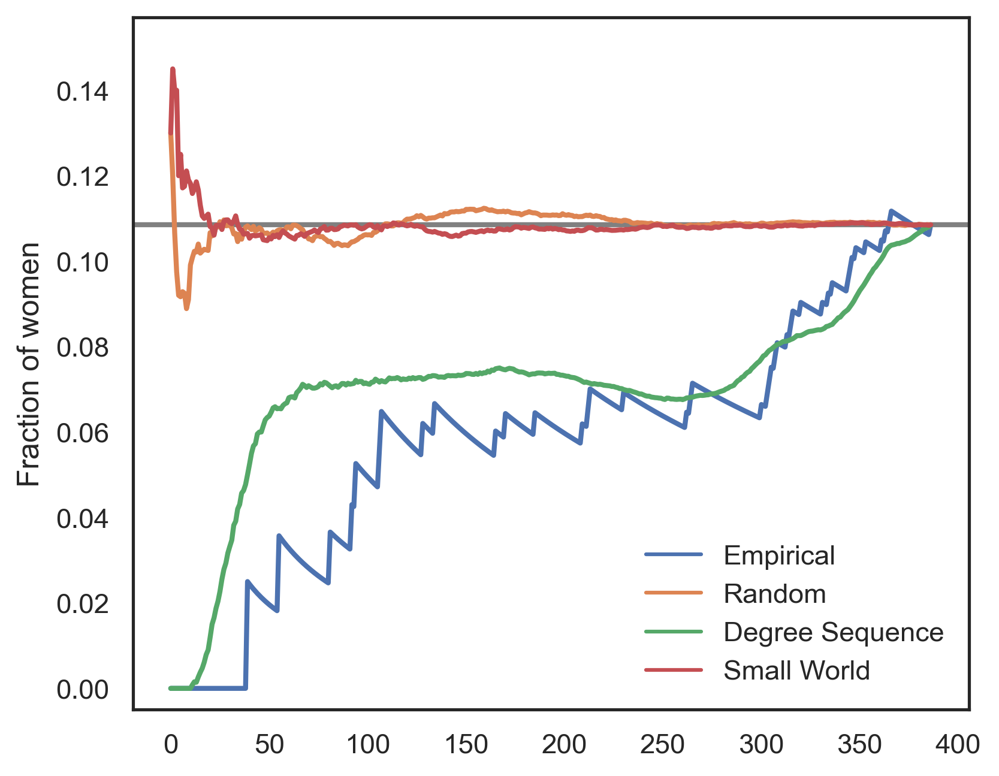

In [109]:
sns.set_theme(style='white')
plt.figure(figsize=[6,5],dpi=300)
plt.axhline(y=f/n, color='grey', linestyle='-', linewidth=2)
sns.lineplot(data=df_rank_pr.iloc[:,:],dashes=False,linewidth = 2)
plt.legend(frameon=False,loc='lower right')
#plt.title('Pagerank',)
plt.ylabel('Fraction of women')
plt.ylim(-0.005,0.157)
plt.savefig('pic/3-pagerank.png', bbox_inches = 'tight')
plt.show()


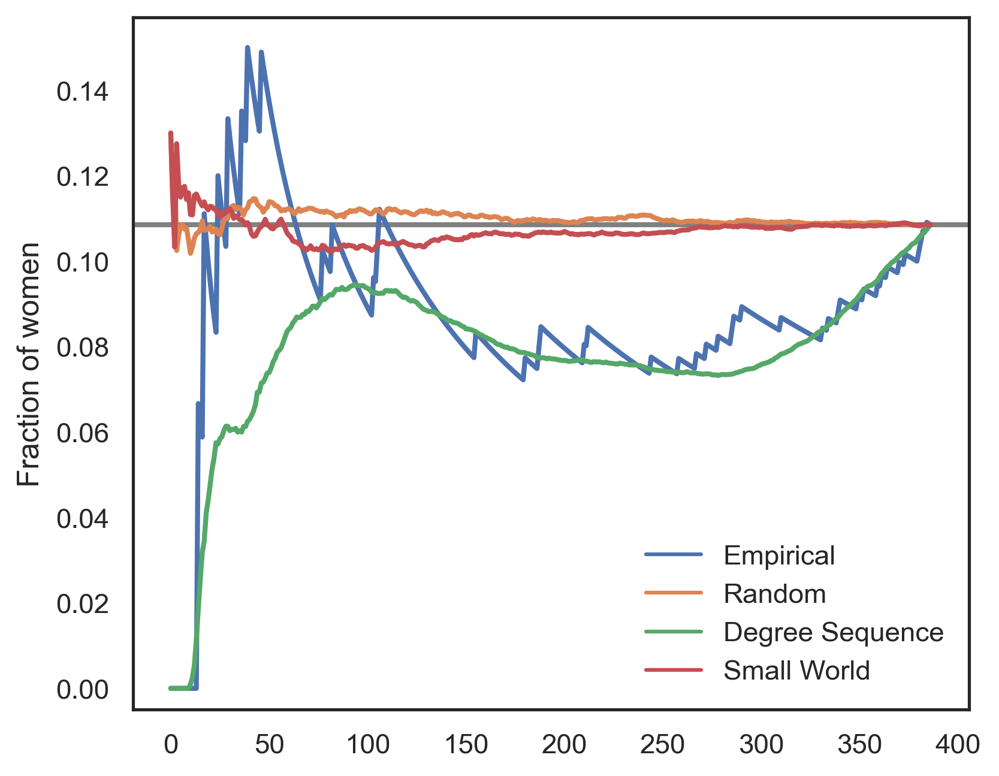

In [110]:
sns.set_theme(style='white')
plt.figure(figsize=[6,5],dpi=300)
plt.axhline(y=f/n, color='grey', linestyle='-', linewidth=2)
sns.lineplot(data=df_rank_comm.iloc[:,:],dashes=False,linewidth = 2)
plt.legend(frameon=False,loc='lower right')
#plt.title('Communicability',)
plt.ylim(-0.005,0.157)
plt.ylabel('Fraction of women')
plt.savefig('pic/3-comm.png', bbox_inches = 'tight')
plt.show()

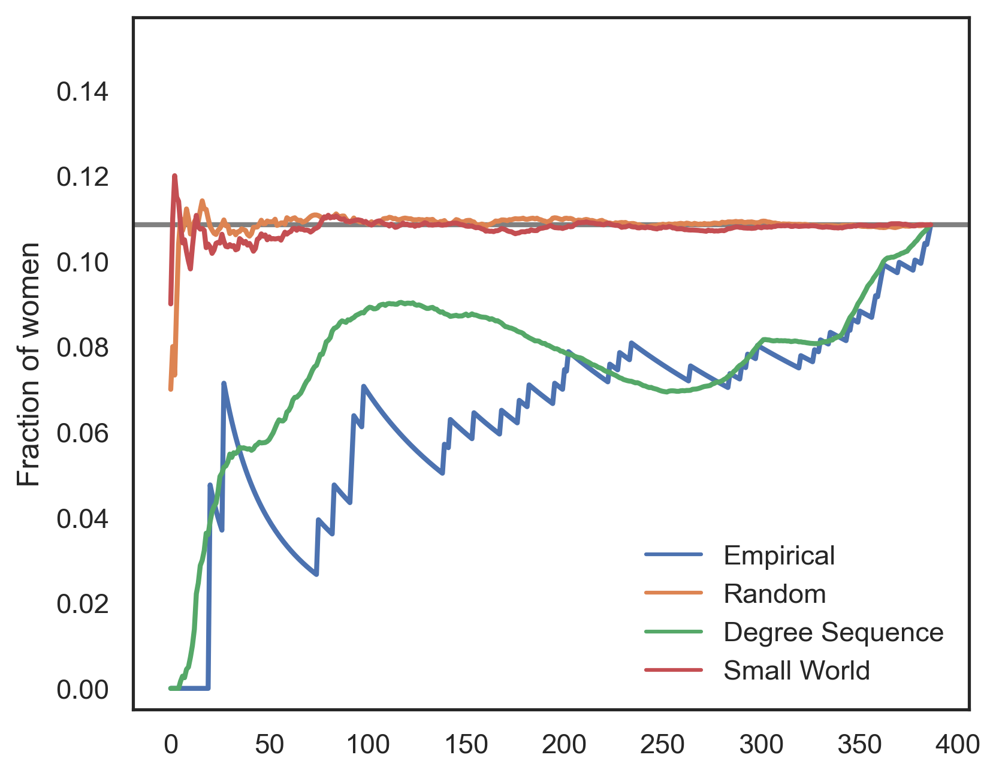

In [111]:
sns.set_theme(style='white')
plt.figure(figsize=[6,5],dpi=300)
plt.axhline(y=f/n, color='grey', linestyle='-', linewidth=2)
sns.lineplot(data=df_rank_bw.iloc[:,:],dashes=False,linewidth = 2)
plt.legend(frameon=False,loc='lower right')
#plt.title('Betweenness',)
plt.ylim(-0.005,0.157)
plt.ylabel('Fraction of women')
plt.savefig('pic/3-bw.png', bbox_inches = 'tight')
plt.show()

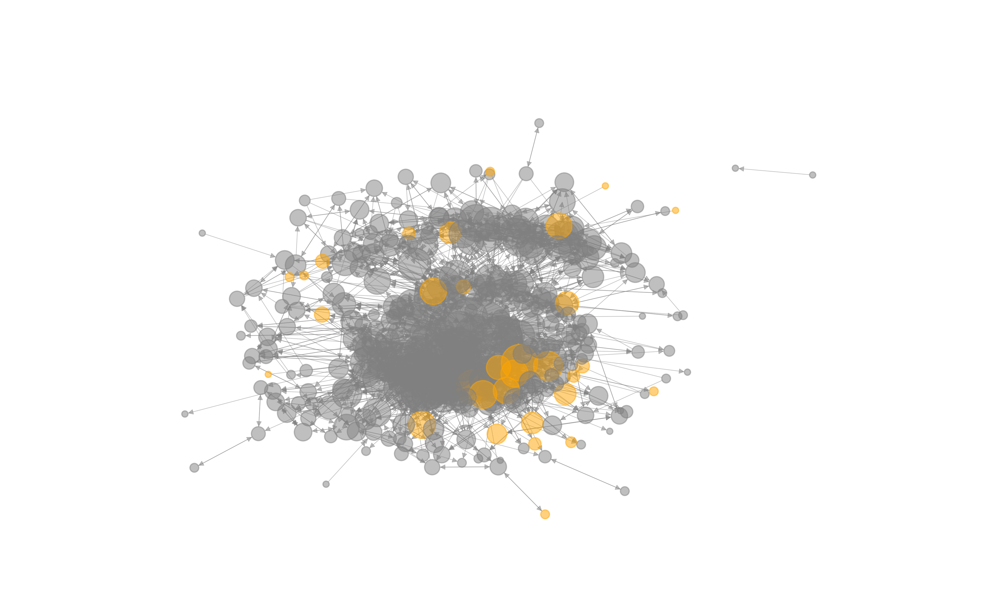

In [112]:
pos=nx.nx_agraph.graphviz_layout(G,)
plt.figure(figsize=[12,7],dpi=300)

color_map = ['orange' if G.nodes[node]['gender'] == 'female' else 'grey' for node in G]

node_options = {'node_color': color_map, 'node_size': [G.degree[v]*30 for v in G]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(G, pos, **node_options, **edge_options)
#plt.axis("equal")
#plt.title('Empirical',{'fontsize': 30})
plt.savefig('pic/3-graph.png', )
plt.show()


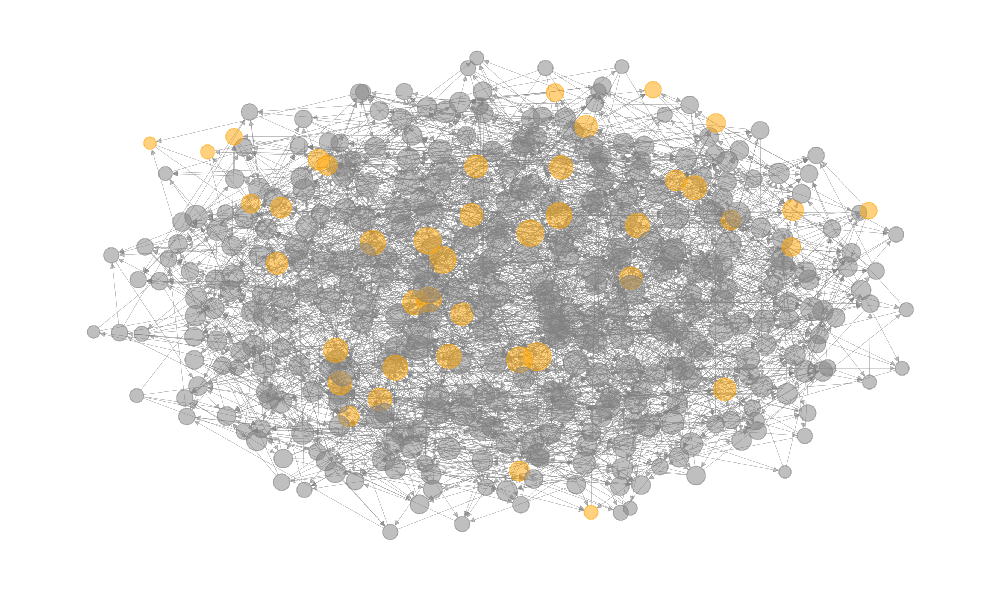

In [113]:
pos=nx.nx_agraph.graphviz_layout(G_random,)
plt.figure(figsize=[12,7],dpi=300)

color_map = ['orange' if G_random.nodes[node]['gender'] == 'female' else 'grey' for node in G_random]

node_options = {'node_color': color_map, 'node_size': [G_random.degree[v]*30 for v in G_random]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(G_random, pos, **node_options, **edge_options)
#plt.title('Random',{'fontsize': 30})
plt.savefig('pic/3-graph-random.png', )
plt.show()

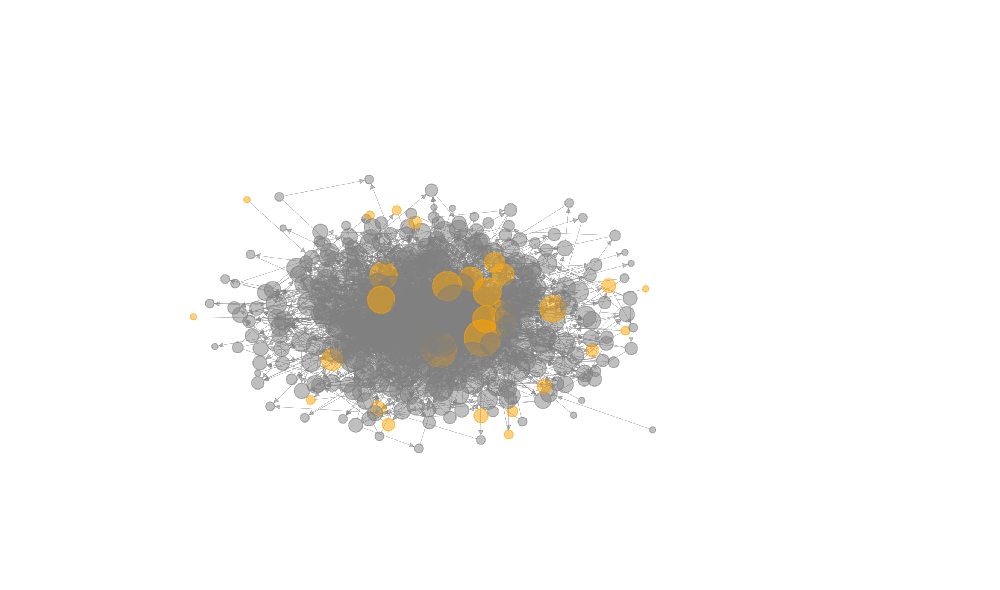

In [114]:

pos=nx.nx_agraph.graphviz_layout(G_degree_sequence,)
plt.figure(figsize=[12,7],dpi=300)

color_map = ['orange' if G_degree_sequence.nodes[node]['gender'] == 'female' else 'grey' for node in G_degree_sequence]

node_options = {'node_color': color_map, 'node_size': [G_degree_sequence.degree[v]*30 for v in G_degree_sequence]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(G_degree_sequence, pos, **node_options, **edge_options)
#plt.title('Degree Sequence',{'fontsize': 30})
plt.savefig('pic/3-graph-degree.png', )
plt.show()

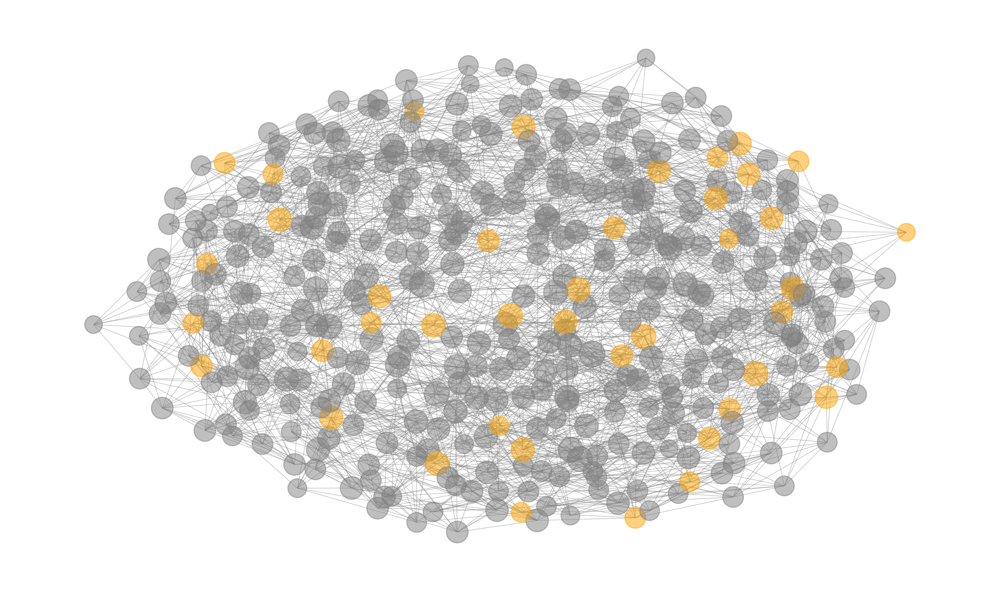

In [115]:
pos=nx.nx_agraph.graphviz_layout(G_small_world,)
plt.figure(figsize=[12,7],dpi=300)

color_map = ['orange' if G_small_world.nodes[node]['gender'] == 'female' else 'grey' for node in G_small_world]

node_options = {'node_color': color_map, 'node_size': [G_small_world.degree[v]*30 for v in G_small_world]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(G_small_world, pos, **node_options, **edge_options)
#plt.title('Small World',{'fontsize': 30})
plt.savefig('pic/3-graph-smallworld.png', )
plt.show()

In [116]:
f/n

0.10852713178294573

### Case (top 50)

In [117]:
df_comm.head(50)

,Importance,Name,Gender,Communicability
Wikidata_Q,,,,
Q154938,0.041052,Bede,male,1.000000
Q719721,-0.000079,Wilfrid,male,0.472594
Q468847,-0.003798,Oswiu,male,0.455677
Q348955,-0.004217,Edwin,male,0.449374
Q164499,-0.002791,Wulfhere,male,0.410664
Q332123,-0.003396,Penda,male,0.405666
Q272275,-0.003327,Aethelwold,male,0.399625
Q336016,-0.002659,Oswald,male,0.394674
Q559247,-0.003057,Anna,male,0.382649


In [118]:
G1 = G.copy()
G1.remove_node('Q154938')

442 33
25 127


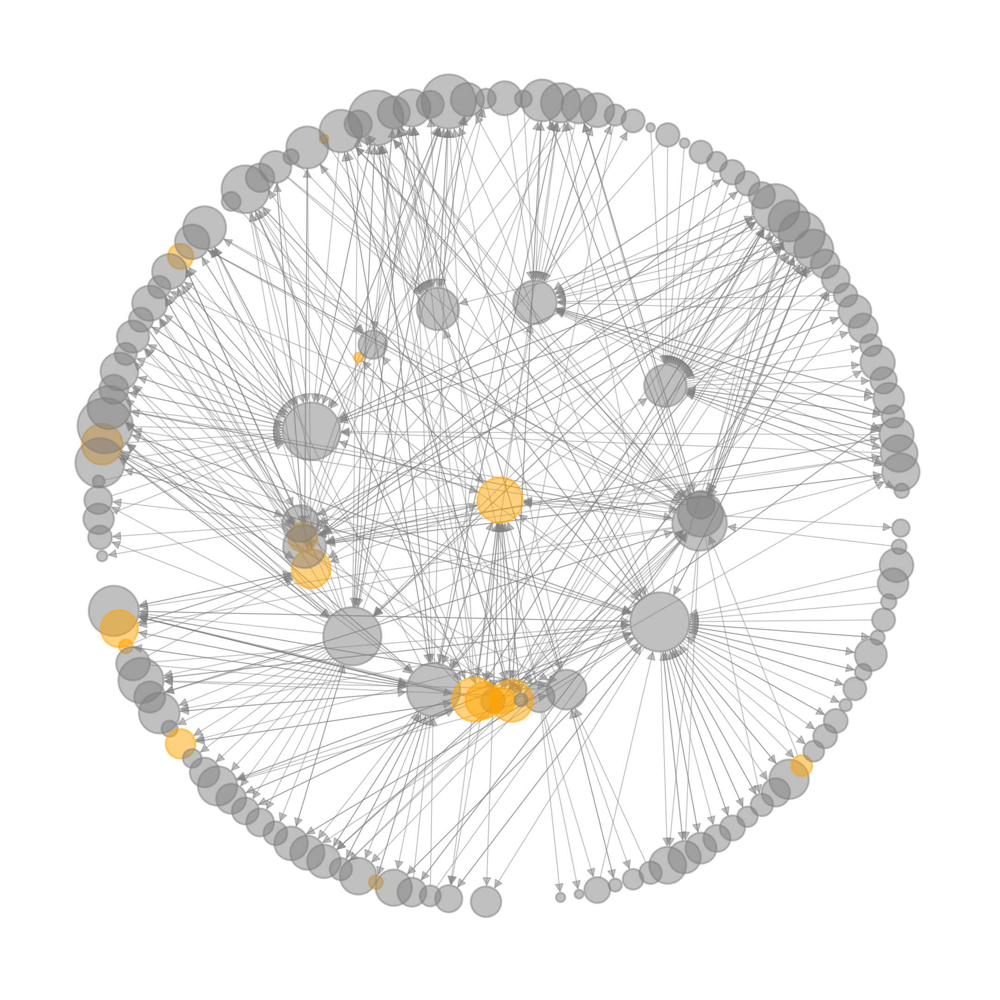

In [119]:
root_node = 'Q257500' #Hild

subgraph1 = nx.ego_graph(G1, root_node, radius=1,undirected=True)
subgraph2 = nx.ego_graph(G1, root_node, radius=2,undirected=True)

for edge in list(subgraph1.edges()):
    if edge[0] != root_node and edge[1] != root_node:
        subgraph2.remove_edge(edge[0], edge[1])
        subgraph1.remove_edge(edge[0], edge[1])


d_1_nodes = set(subgraph1.nodes()) - set(root_node)
d_2_nodes = set(subgraph2.nodes()) - set(subgraph1.nodes())

for edge in list(subgraph2.edges()):
    if edge[0] in d_2_nodes and edge[1] in d_2_nodes:
        subgraph2.remove_edge(edge[0], edge[1])

print(len(set(subgraph2.edges()) - set(subgraph1.edges())),subgraph1.number_of_edges())
print(len(d_1_nodes), len(d_2_nodes))

pos=nx.nx_agraph.graphviz_layout(subgraph2, prog="twopi", args="", root=root_node)
plt.figure(figsize=[7,7],dpi=300)

color_map = ['orange' if subgraph2.nodes[node]['gender'] == 'female' else 'grey' for node in subgraph2]

node_options = {'node_color': color_map, 'node_size': [comm_ud[v]*2000 for v in subgraph2]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(subgraph2, pos, **node_options, **edge_options)
#plt.title('Small World',{'fontsize': 30})
plt.savefig('pic/hild.png', )
plt.show()

In [120]:
subgraph1.edges()

OutEdgeView([('Q672738', 'Q257500'), ('Q4880603', 'Q257500'), ('Q257500', 'Q32520'), ('Q257500', 'Q272173'), ('Q257500', 'Q238352'), ('Q257500', 'Q506645'), ('Q257500', 'Q272196'), ('Q257500', 'Q348955'), ('Q257500', 'Q468847'), ('Q257500', 'Q2266026'), ('Q257500', 'Q291529'), ('Q257500', 'Q132148'), ('Q257500', 'Q559247'), ('Q257500', 'Q2480751'), ('Q257500', 'Q381292'), ('Q257500', 'Q707833'), ('Q257500', 'Q1702263'), ('Q257500', 'Q261097'), ('Q257500', 'Q5738218'), ('Q257500', 'Q4880603'), ('Q272275', 'Q257500'), ('Q707833', 'Q257500'), ('Q504518', 'Q257500'), ('Q719721', 'Q257500'), ('Q2480751', 'Q257500'), ('Q348955', 'Q257500'), ('Q559247', 'Q257500'), ('Q291529', 'Q257500'), ('Q2606192', 'Q257500'), ('Q509072', 'Q257500'), ('Q506645', 'Q257500'), ('Q5738218', 'Q257500'), ('Q381292', 'Q257500')])

371 39
32 118


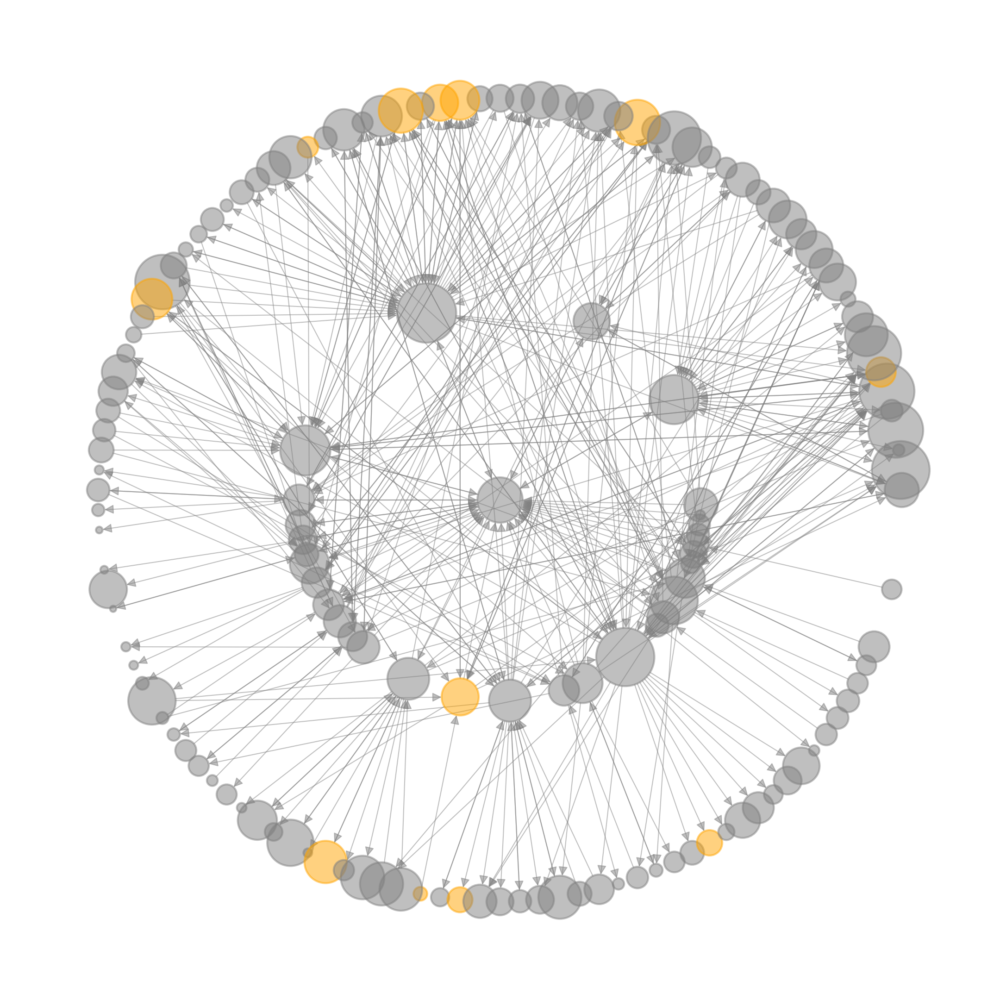

In [121]:
root_node = 'Q504529' #Theo

subgraph1 = nx.ego_graph(G1, root_node, radius=1,undirected=True)
subgraph2 = nx.ego_graph(G1, root_node, radius=2,undirected=True)

for edge in list(subgraph1.edges()):
    if edge[0] != root_node and edge[1] != root_node:
        subgraph2.remove_edge(edge[0], edge[1])
        subgraph1.remove_edge(edge[0], edge[1])


d_1_nodes = set(subgraph1.nodes()) - set(root_node)
d_2_nodes = set(subgraph2.nodes()) - set(subgraph1.nodes())

for edge in list(subgraph2.edges()):
    if edge[0] in d_2_nodes and edge[1] in d_2_nodes:
        subgraph2.remove_edge(edge[0], edge[1])

print(len(set(subgraph2.edges()) - set(subgraph1.edges())),subgraph1.number_of_edges())
print(len(d_1_nodes), len(d_2_nodes))
        
pos=nx.nx_agraph.graphviz_layout(subgraph2, prog="twopi", args="", root=root_node)
plt.figure(figsize=[7,7],dpi=300)

color_map = ['orange' if subgraph2.nodes[node]['gender'] == 'female' else 'grey' for node in subgraph2]

node_options = {'node_color': color_map, 'node_size': [comm_ud[v]*2000 for v in subgraph2]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(subgraph2, pos, **node_options, **edge_options)
#plt.title('Small World',{'fontsize': 30})
plt.savefig('pic/Theo.png', )
plt.show()

417 30
20 128


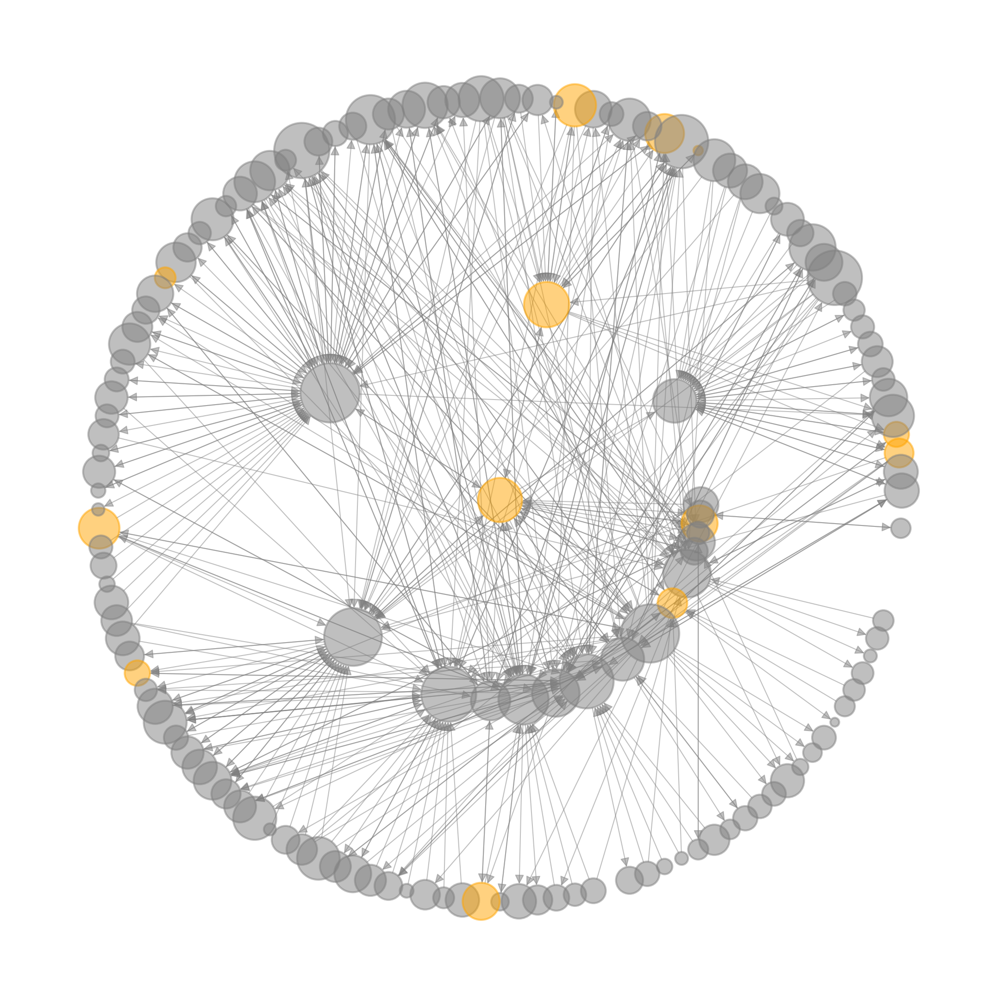

In [122]:
root_node = 'Q291529'#Eanflaed

subgraph1 = nx.ego_graph(G1, root_node, radius=1,undirected=True)
subgraph2 = nx.ego_graph(G1, root_node, radius=2,undirected=True)

for edge in list(subgraph1.edges()):
    if edge[0] != root_node and edge[1] != root_node:
        subgraph2.remove_edge(edge[0], edge[1])
        subgraph1.remove_edge(edge[0], edge[1])


d_1_nodes = set(subgraph1.nodes()) - set(root_node)
d_2_nodes = set(subgraph2.nodes()) - set(subgraph1.nodes())

for edge in list(subgraph2.edges()):
    if edge[0] in d_2_nodes and edge[1] in d_2_nodes:
        subgraph2.remove_edge(edge[0], edge[1])

print(len(set(subgraph2.edges()) - set(subgraph1.edges())),subgraph1.number_of_edges())
print(len(d_1_nodes), len(d_2_nodes))

pos=nx.nx_agraph.graphviz_layout(subgraph2, prog="twopi", args="", root=root_node)
plt.figure(figsize=[7,7],dpi=300)

color_map = ['orange' if subgraph2.nodes[node]['gender'] == 'female' else 'grey' for node in subgraph2]

node_options = {'node_color': color_map, 'node_size': [comm_ud[v]*2000 for v in subgraph2]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(subgraph2, pos, **node_options, **edge_options)
#plt.title('Small World',{'fontsize': 30})
plt.savefig('pic/Eanflaed.png', )
plt.show()

341 37
28 125


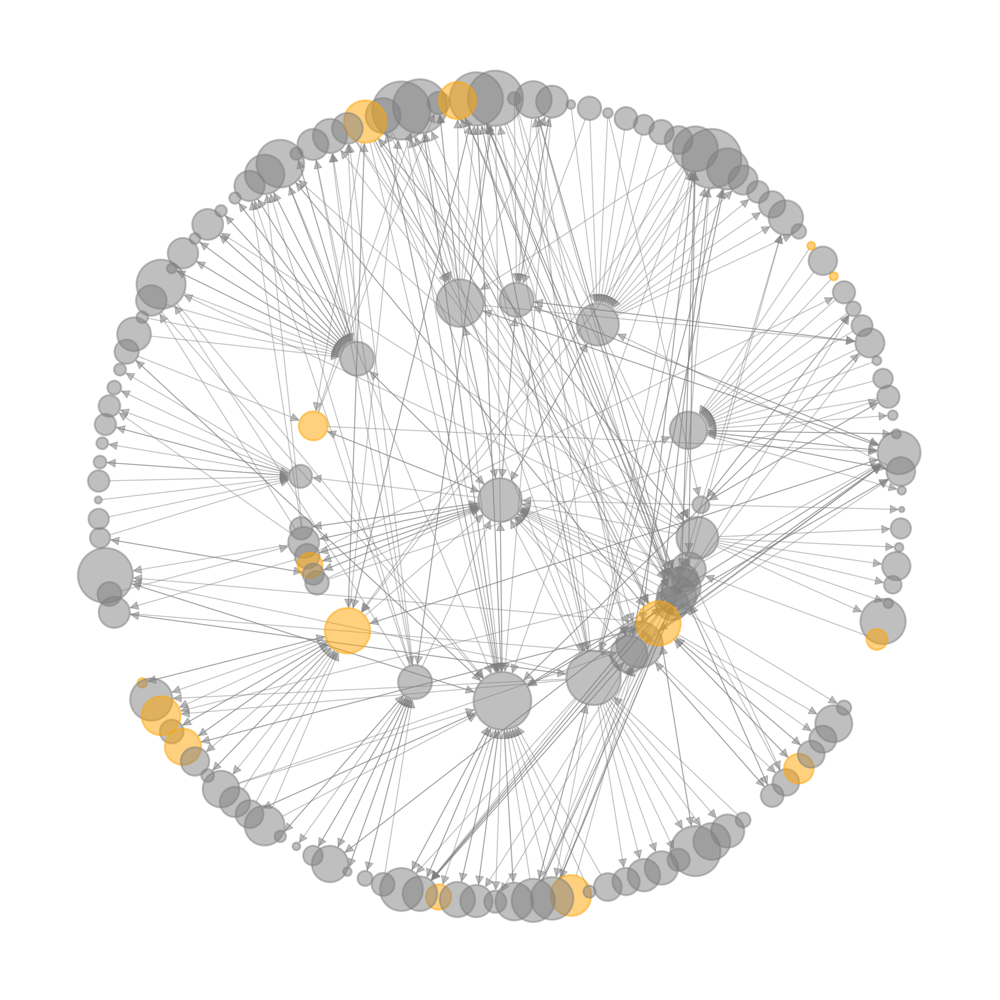

In [123]:
root_node = 'Q272173' #Ethelberht of Kent

subgraph1 = nx.ego_graph(G1, root_node, radius=1,undirected=True)
subgraph2 = nx.ego_graph(G1, root_node, radius=2,undirected=True)

for edge in list(subgraph1.edges()):
    if edge[0] != root_node and edge[1] != root_node:
        subgraph2.remove_edge(edge[0], edge[1])
        subgraph1.remove_edge(edge[0], edge[1])


d_1_nodes = set(subgraph1.nodes()) - set(root_node)
d_2_nodes = set(subgraph2.nodes()) - set(subgraph1.nodes())

for edge in list(subgraph2.edges()):
    if edge[0] in d_2_nodes and edge[1] in d_2_nodes:
        subgraph2.remove_edge(edge[0], edge[1])

print(len(set(subgraph2.edges()) - set(subgraph1.edges())),subgraph1.number_of_edges())
print(len(d_1_nodes), len(d_2_nodes))

pos=nx.nx_agraph.graphviz_layout(subgraph2, prog="twopi", root=root_node)
#pos[root_node] == [0,0]
plt.figure(figsize=[7,7],dpi=300)

color_map = ['orange' if subgraph2.nodes[node]['gender'] == 'female' else 'grey' for node in subgraph2]

node_options = {'node_color': color_map, 'node_size': [comm_ud[v]*2000 for v in subgraph2]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(subgraph2, pos, **node_options, **edge_options)
#plt.title('Small World',{'fontsize': 30})
plt.savefig('pic/Ethelberht.png', )
plt.show()

347 18
14 114


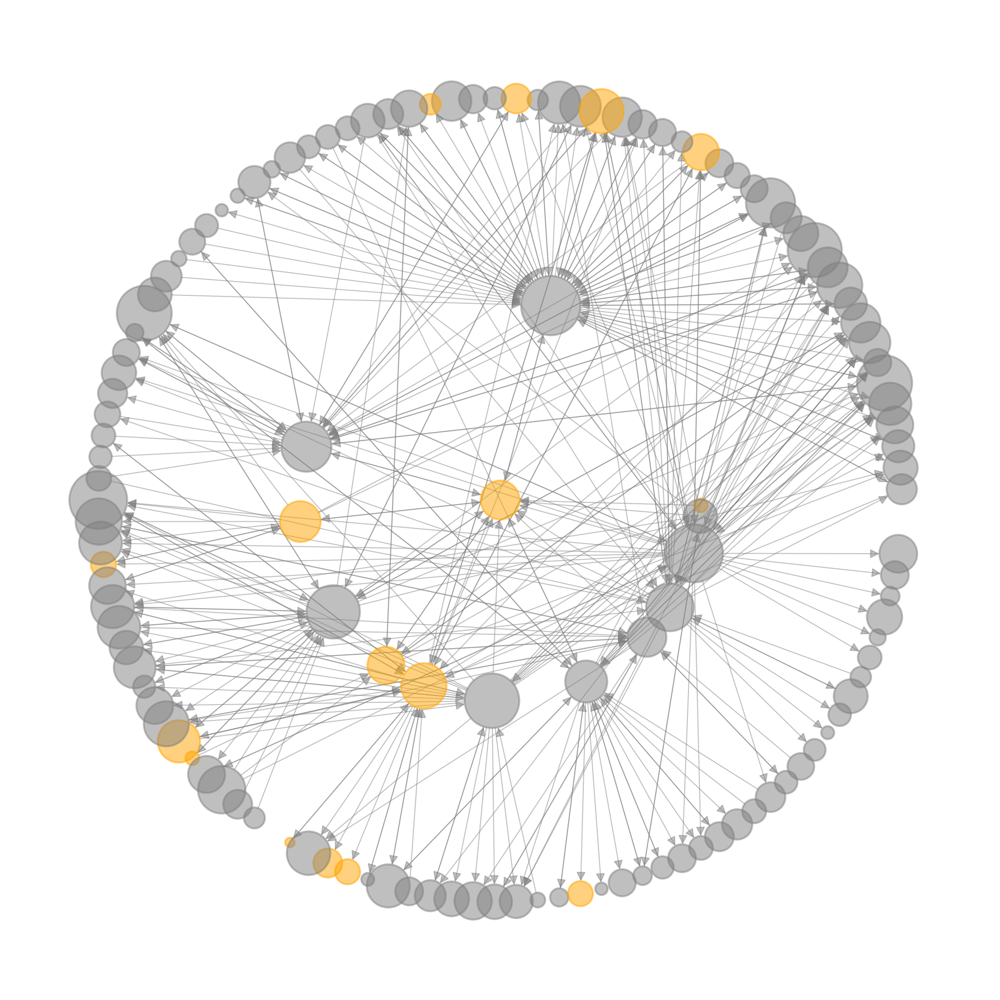

In [124]:
root_node = 'Q261097' #Etheldreda

subgraph1 = nx.ego_graph(G1, root_node, radius=1,undirected=True)
subgraph2 = nx.ego_graph(G1, root_node, radius=2,undirected=True)

for edge in list(subgraph1.edges()):
    if edge[0] != root_node and edge[1] != root_node:
        subgraph2.remove_edge(edge[0], edge[1])
        subgraph1.remove_edge(edge[0], edge[1])


d_1_nodes = set(subgraph1.nodes()) - set(root_node)
d_2_nodes = set(subgraph2.nodes()) - set(subgraph1.nodes())

for edge in list(subgraph2.edges()):
    if edge[0] in d_2_nodes and edge[1] in d_2_nodes:
        subgraph2.remove_edge(edge[0], edge[1])

print(len(set(subgraph2.edges()) - set(subgraph1.edges())),subgraph1.number_of_edges())
print(len(d_1_nodes), len(d_2_nodes))

pos=nx.nx_agraph.graphviz_layout(subgraph2, prog="twopi", root=root_node)
#pos[root_node] == [0,0]
plt.figure(figsize=[7,7],dpi=300)

color_map = ['orange' if subgraph2.nodes[node]['gender'] == 'female' else 'grey' for node in subgraph2]

node_options = {'node_color': color_map, 'node_size': [comm_ud[v]*2000 for v in subgraph2]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(subgraph2, pos, **node_options, **edge_options)
#plt.title('Small World',{'fontsize': 30})
plt.savefig('pic/Etheldreda.png', )
plt.show()

249 23
17 95


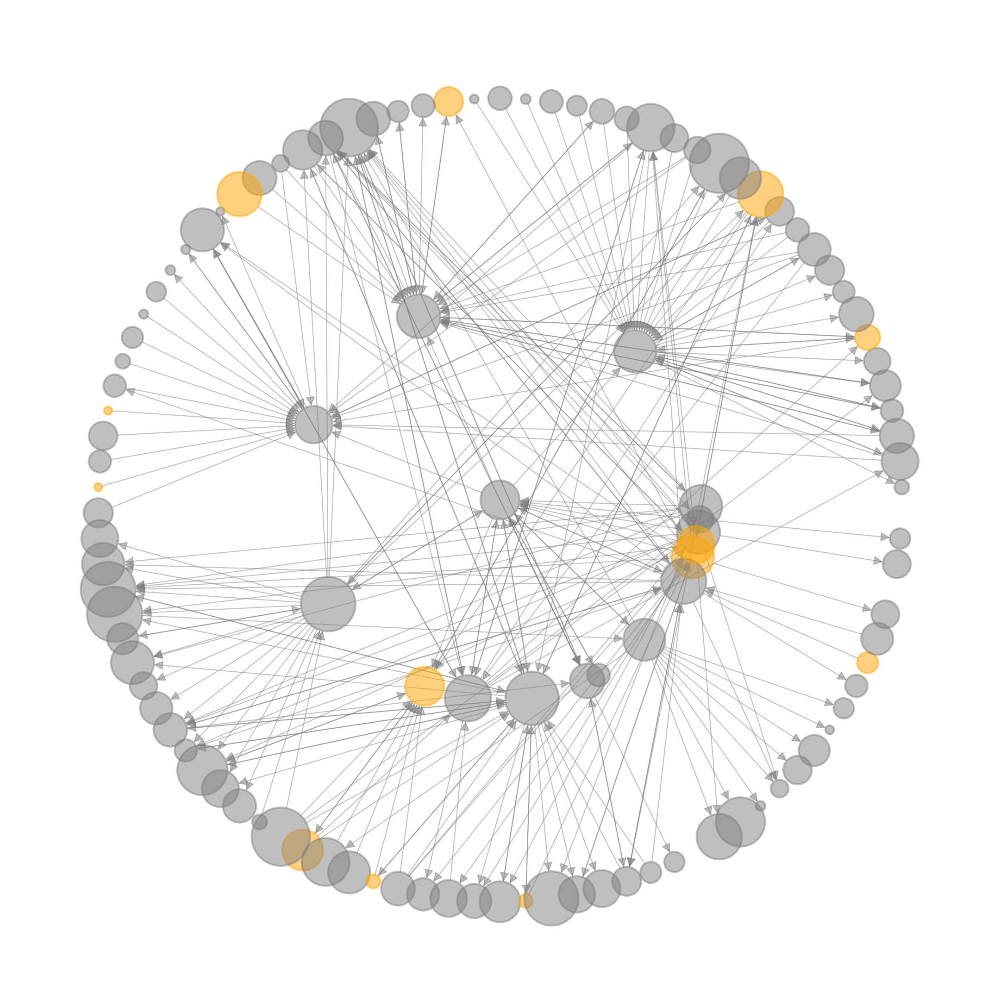

In [125]:
root_node = 'Q1343094' #Eri

subgraph1 = nx.ego_graph(G1, root_node, radius=1,undirected=True)
subgraph2 = nx.ego_graph(G1, root_node, radius=2,undirected=True)

for edge in list(subgraph1.edges()):
    if edge[0] != root_node and edge[1] != root_node:
        subgraph2.remove_edge(edge[0], edge[1])
        subgraph1.remove_edge(edge[0], edge[1])


d_1_nodes = set(subgraph1.nodes()) - set(root_node)
d_2_nodes = set(subgraph2.nodes()) - set(subgraph1.nodes())

for edge in list(subgraph2.edges()):
    if edge[0] in d_2_nodes and edge[1] in d_2_nodes:
        subgraph2.remove_edge(edge[0], edge[1])

print(len(set(subgraph2.edges()) - set(subgraph1.edges())),subgraph1.number_of_edges())
print(len(d_1_nodes), len(d_2_nodes))

pos=nx.nx_agraph.graphviz_layout(subgraph2, prog="twopi", root=root_node)
#pos[root_node] == [0,0]
plt.figure(figsize=[7,7],dpi=300)

color_map = ['orange' if subgraph2.nodes[node]['gender'] == 'female' else 'grey' for node in subgraph2]

node_options = {'node_color': color_map, 'node_size': [comm_ud[v]*2000 for v in subgraph2]}
edge_options = {'edge_color': 'grey', 'alpha': .5, 'width': .5}

nx.draw(subgraph2, pos, **node_options, **edge_options)
#plt.title('Small World',{'fontsize': 30})
plt.savefig('pic/Eni.png', )
plt.show()

In [126]:
df_comm['clustering_coef'] = pd.Series(nx.clustering(G))
#df_comm

In [127]:
df_comm['d1_to_d2'] = ''
df_comm['d2_to_d1'] = ''
df_comm['sub_ratio'] = ''
df_comm['edge_ratio'] = ''
df_comm['node_ratio'] = ''
df_comm['neigh_comm'] = ''
for root_node in df_comm.index[1:]:

    subgraph1 = nx.ego_graph(G, root_node, radius=1,undirected=True)
    subgraph2 = nx.ego_graph(G, root_node, radius=2,undirected=True)

    d_1_nodes = set(subgraph1.nodes()) - set(root_node)
    d_2_nodes = set(subgraph2.nodes()) - set(subgraph1.nodes())

    edges_0_1, edges_1_2 = 0, 0
    for edge in list(subgraph2.edges()):
        if edge[0] == root_node and edge[1] in d_1_nodes:
            edges_0_1 += 1
        if edge[0] in d_1_nodes and edge[1] in d_2_nodes:
            edges_1_2 += 1
    
    edges_1_0, edges_2_1 = 0, 0
    for edge in list(subgraph2.edges()):
        if edge[0] in d_1_nodes and edge[1] == root_node:
            edges_1_0 += 1
        if edge[0] in d_2_nodes and edge[1] in d_1_nodes:
            edges_2_1 += 1
    
    comm_sum = sum([df_comm.at[node,'Communicability'] for node in d_1_nodes])
    df_comm.at[root_node, 'neigh_comm'] =  comm_sum / len(d_1_nodes)
    
    if edges_1_2 > 0:
        df_comm.at[root_node, 'd1_to_d2'] = edges_0_1 / edges_1_2
    if edges_2_1 > 0:
        df_comm.at[root_node, 'd2_to_d1'] = edges_1_0 / edges_2_1
    if (edges_1_2+edges_2_1)>0:
        df_comm.at[root_node, 'sub_ratio'] = (edges_0_1+edges_1_0) / subgraph2.number_of_edges()#(edges_1_2+edges_2_1)
    if subgraph2.number_of_nodes()>0:
        df_comm.at[root_node, 'node_ratio'] = subgraph1.number_of_nodes() / subgraph2.number_of_nodes()
    if subgraph2.number_of_edges()>0:
        df_comm.at[root_node, 'edge_ratio'] = subgraph1.number_of_edges() / subgraph2.number_of_edges()

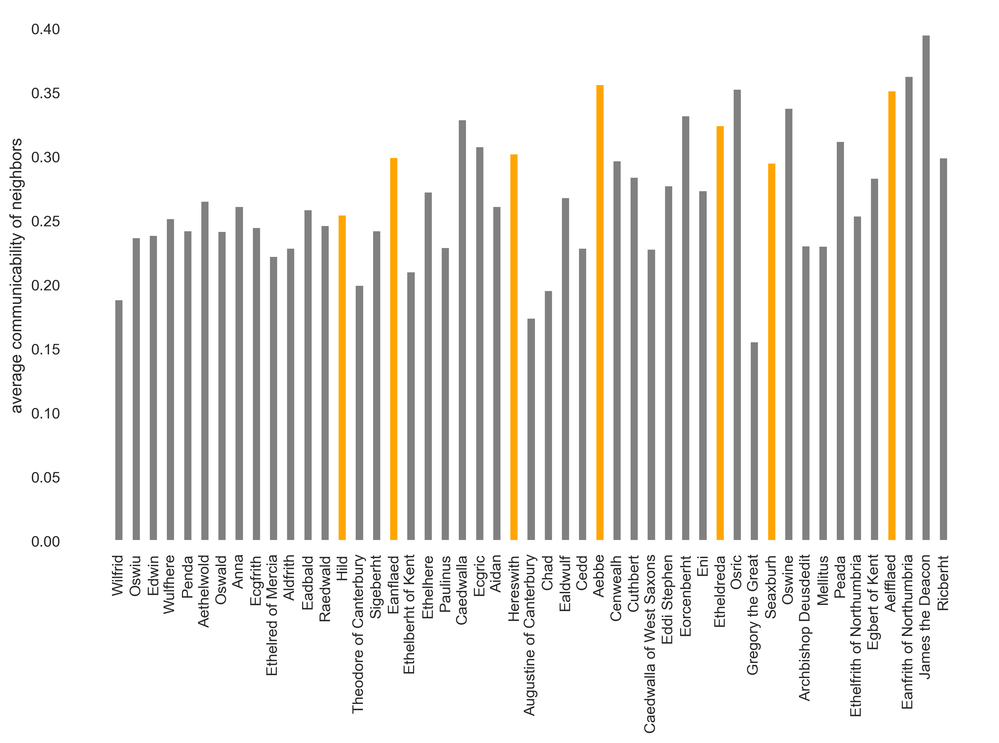

In [128]:
plt.figure(figsize=[12,7],dpi=300)
colors = []
for gender in df_comm['Gender'][1:]:
    if gender == 'male':
        colors.append('grey')
    else:
        colors.append('orange')

plt.bar(df_comm.head(50).Name[1:], df_comm.head(50)['neigh_comm'][1:], width=0.5,color = colors)

plt.xticks(rotation=90)
plt.xlabel('')
plt.ylabel('average communicability of neighbors')
plt.box(False)
plt.savefig('pic/neigh_comm.png', bbox_inches='tight')
plt.show()

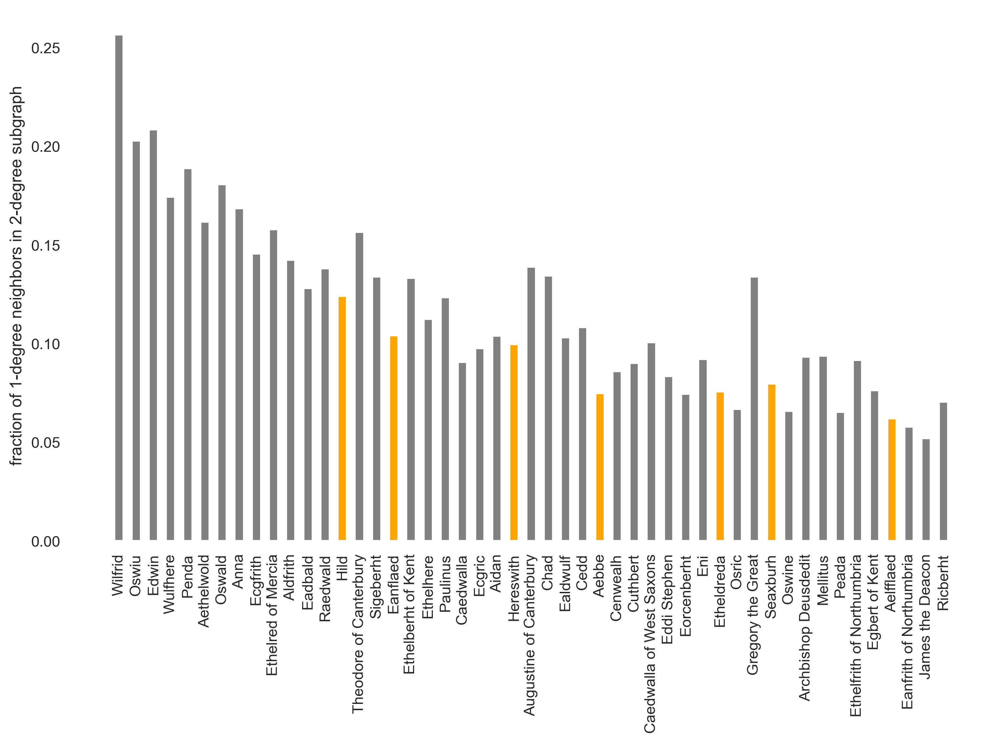

In [129]:
plt.figure(figsize=[12,7],dpi=300)
colors = []
for gender in df_comm['Gender'][1:]:
    if gender == 'male':
        colors.append('grey')
    else:
        colors.append('orange')

plt.bar(df_comm.head(50).Name[1:], df_comm.head(50)['node_ratio'][1:], width=0.5,color = colors)

plt.xticks(rotation=90)
plt.xlabel('')
plt.ylabel('fraction of 1-degree neighbors in 2-degree subgraph')
plt.box(False)
plt.savefig('pic/node_ratio.png', bbox_inches='tight')
plt.show()

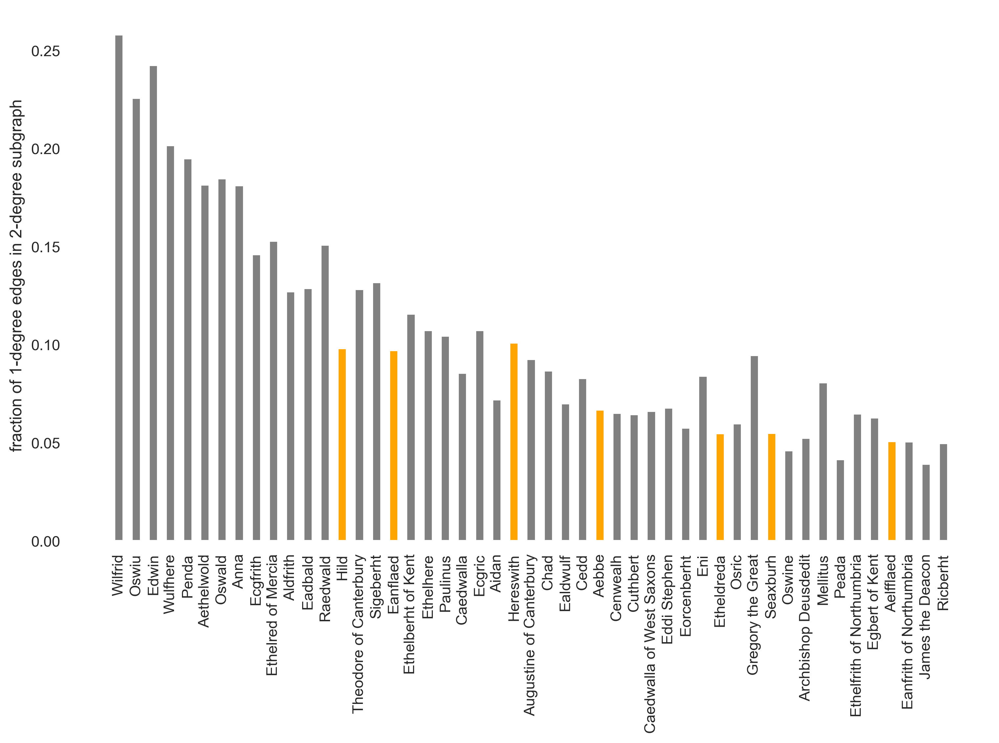

In [130]:
plt.figure(figsize=[12,7],dpi=300)
colors = []
for gender in df_comm['Gender'][1:]:
    if gender == 'male':
        colors.append('grey')
    else:
        colors.append('orange')

plt.bar(df_comm.head(50).Name[1:], df_comm.head(50)['edge_ratio'][1:], width=0.5,color = colors)

plt.xticks(rotation=90)
plt.xlabel('')
plt.ylabel('fraction of 1-degree edges in 2-degree subgraph')
plt.box(False)
plt.savefig('pic/edge_ratio.png', bbox_inches='tight')
plt.show()

In [131]:
# plt.figure(figsize=[12,7],dpi=300)
# colors = []
# for gender in df_comm['Gender'][1:]:
#     if gender == 'male':
#         colors.append('grey')
#     else:
#         colors.append('orange')

# plt.bar(df_comm.head(50).Name[1:], df_comm.head(50)['sub_ratio'][1:], width=0.5,color = colors)

# plt.xticks(rotation=90)
# plt.box(False)

# plt.xlabel('')
# plt.ylabel('Ratio: 1-degree connections / 2-degree connections')
# plt.savefig('pic/sub_ratio.png', bbox_inches='tight')
# plt.show()

In [132]:
df_comm.iloc[1:50,:].groupby('Gender')['edge_ratio'].mean()

Gender
female    0.074671
male      0.109586
Name: edge_ratio, dtype: float64

In [133]:
df_comm.columns

Index(['Importance', 'Name', 'Gender', 'Communicability', 'clustering_coef',
       'd1_to_d2', 'd2_to_d1', 'sub_ratio', 'edge_ratio', 'node_ratio',
       'neigh_comm'],
      dtype='object')

In [134]:
temp = df_comm[1:50].dropna()

In [135]:
temp['Gender'] = temp['Gender'].astype(str)
temp['neigh_comm'] = temp['neigh_comm'].astype(float)
temp['Communicability'] = temp['Communicability'].astype(float)
temp['node_ratio'] = temp['node_ratio'].astype(float)
temp['sub_ratio'] = temp['sub_ratio'].astype(float)
temp['edge_ratio'] = temp['edge_ratio'].astype(float)

<Figure size 3600x2100 with 0 Axes>

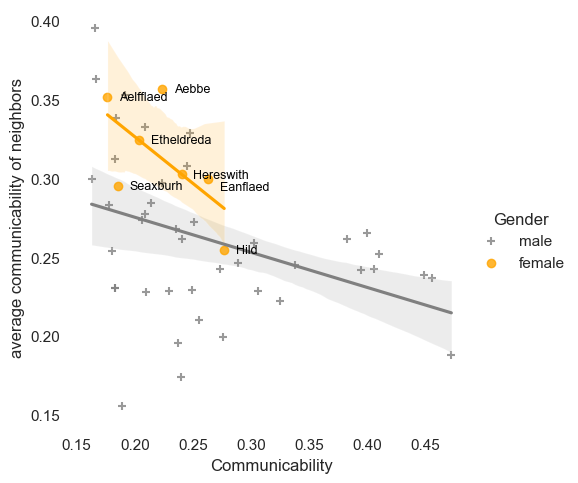

In [136]:
sns.set_theme(style='white')
plt.figure(figsize=[12,7],dpi=300)
sns.lmplot(data=temp, x='Communicability', y = 'neigh_comm', hue='Gender', palette=['grey','orange'],markers=['+','o'])
plt.xlabel('Communicability')
plt.ylabel('average communicability of neighbors')
for i in temp.index:
    if gender_dict[i] =='female':
        if i!='Q291529':
            plt.annotate(G.nodes[i]['name'],xy=(temp.at[i,'Communicability'], temp.at[i,'neigh_comm']), xytext=(temp.at[i,'Communicability']+0.01, temp.at[i,'neigh_comm']-0.002),fontsize=9, color='black')
        else:
            plt.annotate(G.nodes[i]['name'],xy=(temp.at[i,'Communicability'], temp.at[i,'neigh_comm']), xytext=(temp.at[i,'Communicability']+0.01, temp.at[i,'neigh_comm']-0.007),fontsize=9, color='black')

plt.box(False)
plt.savefig('pic/neigh_comm_corr.png', bbox_inches='tight')

plt.show()

<Figure size 3600x2100 with 0 Axes>

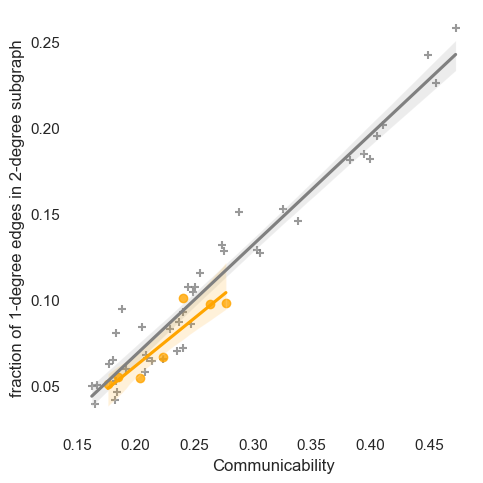

In [137]:
plt.figure(figsize=[12,7],dpi=300)

sns.lmplot(data=temp, x='Communicability', y = 'edge_ratio', hue='Gender', palette=['grey','orange'],markers=['+','o'],legend=False)
plt.xlabel('Communicability')
plt.ylabel('fraction of 1-degree edges in 2-degree subgraph')
plt.box(False)
plt.savefig('pic/edge_ratio_corr.png', bbox_inches='tight')

plt.show()


<Figure size 3600x2100 with 0 Axes>

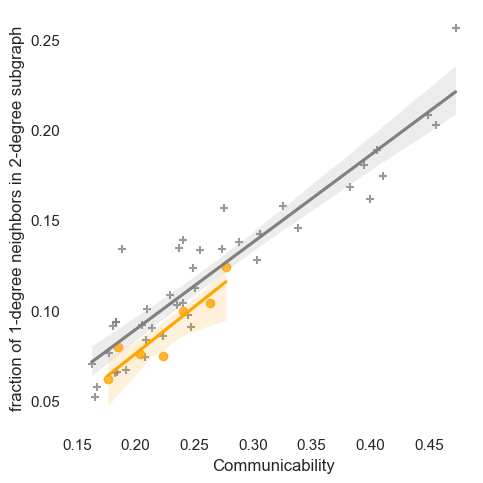

In [138]:
plt.figure(figsize=(12, 7), dpi=300)
sns.lmplot(data=temp, x='Communicability', y = 'node_ratio', hue='Gender', palette=['grey','orange'],markers=['+','o'],legend=False)
plt.xlabel('Communicability')
plt.ylabel('fraction of 1-degree neighbors in 2-degree subgraph')
plt.box(False)
plt.savefig('pic/node_ratio_corr.png', bbox_inches='tight')

plt.show()

# others